In [1]:
# sphinx_gallery_thumbnail_number = 2

# Authors: Robert Luke <mail@robertluke.net>
#
# License: BSD (3-clause)

# Import common libraries
from collections import defaultdict
from copy import deepcopy
from itertools import compress
from pprint import pprint

# Import Plotting Library
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import numpy as np
import os
import pywt


# Import StatsModels
import statsmodels.formula.api as smf
from mne import Epochs, events_from_annotations, set_log_level
from mne.preprocessing.nirs import (
    beer_lambert_law,
    optical_density,
    scalp_coupling_index,
    temporal_derivative_distribution_repair,
    
)

# Import MNE processing
from mne.viz import plot_compare_evokeds

# Import MNE-BIDS processing
from mne_bids import BIDSPath, read_raw_bids


# Import MNE-NIRS processing
from mne_nirs.channels import get_long_channels, picks_pair_to_idx
from mne_nirs.datasets import fnirs_motor_group
from mne_nirs.signal_enhancement import (enhance_negative_correlation, short_channel_regression)
from mne_nirs.channels import (get_long_channels,
                               get_short_channels,
                               picks_pair_to_idx)

from collections import defaultdict
import numpy as np
from itertools import compress
from sklearn.decomposition import PCA

# Set general parameters
set_log_level("WARNING")  # Don't show info, as it is repetitive for many subjects

In [20]:
import mne
# cropping the signal before sci calculation
def individual_analysis(bids_path, optode_id):
    # Read data with annotations in BIDS format
    raw_intensity = read_raw_bids(bids_path=bids_path, verbose=False)
    # check if coordinates of the channels
    
    
    #print(raw_intensity.ch_names)

    
    # Get event timings
    #print("Extracting event timings...")
    Breaks, _ = mne.events_from_annotations(raw_intensity, {'Xstart': 4, 'Xend': 5})
    AllEvents, _ = mne.events_from_annotations(raw_intensity)
    Breaks = Breaks[:, 0] / raw_intensity.info['sfreq']
    LastEvent = AllEvents[-1, 0] / raw_intensity.info['sfreq']
    
    if len(Breaks) % 2 == 0:
        raise ValueError("Breaks array should have an odd number of elements.")
    
    original_duration = raw_intensity.times[-1] - raw_intensity.times[0]
    #print(f"Original duration: {original_duration:.2f} seconds")
    
    # Cropping dataset
    #print("Cropping the dataset...")
    cropped_intensity = raw_intensity.copy().crop(Breaks[0], Breaks[1])
    for j in range(2, len(Breaks) - 1, 2):
        block = raw_intensity.copy().crop(Breaks[j], Breaks[j + 1])
        cropped_intensity.append(block)
    cropped_intensity.append(raw_intensity.copy().crop(Breaks[-1], LastEvent + 15.25))
    
    cropped_duration = cropped_intensity.times[-1] - cropped_intensity.times[0]
    #print(f"Cropped duration: {cropped_duration:.2f} seconds")
    
    if cropped_duration >= original_duration:
        print(f"WARNING: Cropping did not reduce duration!")
    
    raw_intensity_cropped = cropped_intensity.copy()

    

    
    # Remove break annotations
    print("Removing break annotations for the orginal raw...")
    raw_intensity.annotations.delete(np.where(
        (raw_intensity.annotations.description == 'Xstart') | 
        (raw_intensity.annotations.description == 'Xend') | 
        (raw_intensity.annotations.description == 'BAD boundary') | 
        (raw_intensity.annotations.description == 'EDGE boundary')
    )[0])
    
    print("Removing break annotations for the cropped raw...")
    raw_intensity_cropped.annotations.delete(np.where(
        (raw_intensity_cropped.annotations.description == 'Xstart') | 
        (raw_intensity_cropped.annotations.description == 'Xend') | 
        (raw_intensity_cropped.annotations.description == 'BAD boundary') | 
        (raw_intensity_cropped.annotations.description == 'EDGE boundary')
    )[0]) 
    
    
    #downsampling the signal
    #raw_intensity_cropped.resample(3)
    
    # Convert signal to optical density and determine bad channels
    raw_od = optical_density(raw_intensity)
    raw_od_cropped = optical_density(raw_intensity_cropped)
    
    # get the total number of short channels
    short_chs = get_short_channels(raw_od)
    tot_number_of_short_channels = len(short_chs.ch_names)
    

    # sci calculated
    sci = scalp_coupling_index(raw_od_cropped, l_freq=0.7, h_freq=1.45)
    #sci = scalp_coupling_index(raw_od_cropped, h_freq=1.35)
    bad_channels= list(compress(raw_od.ch_names, sci < 0.8))
    
    if len(bad_channels) > 55:
        print(f"❌ Too many bad channels ({len(bad_channels)}). Excluding subject from analysis.")
        return None, None, None, None
    
    raw_od.info["bads"] = bad_channels
    raw_intensity_cropped.info["bads"] = bad_channels
    
    print(f"Bad channels: {raw_od.info['bads']}")
    # print the number of bad channels
    print(f"Number of bad channels: {len(raw_od.info['bads'])}")
    
    # Remove bad channels
   
    """ raw_od.drop_channels(bad_channels)
    raw_intensity_cropped.drop_channels(bad_channels) """
    
    raw_od = temporal_derivative_distribution_repair(raw_od)
    raw_od_cropped = temporal_derivative_distribution_repair(raw_od_cropped)

    
     # Get long channels
    long_chs = get_long_channels(raw_od)
    bad_long_chs = long_chs.info["bads"]
    
    """ print(f"Number of all (good and bad) short channels: {tot_number_of_short_channels}")
    print(f"Number of bad long channels: {len(bad_long_chs)}")
    print(f"Number of long and short bad channels: {len(bad_channels)}") """
    # print the number of short bad channels
    len_bad_short_chs = len(bad_channels) - len(bad_long_chs)
    #print(f"Number of bad short channels: {len_bad_short_chs}")
    
    # Determine if there are short channels
    if  len_bad_short_chs == tot_number_of_short_channels:
        print("❌ No short channels found. Skipping the subject.")
        return None, None, None, None # Keep the data unchanged
    else:
        #print("Applying short-channel regression.")
        raw_od_corrected = short_channel_regression(raw_od)
        # drop the bad channels
        #raw_od_corrected.drop_channels(bad_channels)
        
        # interpolate the bad channels
        #raw_od_corrected.interpolate_bads()
        
    # short-channel regression subtracts a scaled version of the signal obtained from the nearest short channel from the signal obtained from the long channel. 

    raw_haemo = beer_lambert_law(raw_od_corrected, ppf=0.1)
    
    #raw_haemo = get_long_channels(raw_haemo, min_dist=0.02, max_dist=0.04) # max_dist 40mm
    raw_haemo = get_long_channels(raw_haemo, min_dist=0.02) 
    
    #raw_haemo = enhance_negative_correlation(raw_haemo)
   
    

    # Convert to haemoglobin and filter
    
    # check the ppf
    
    #raw_haemo.plot_psd(average=True, show=True)
    
    """ raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.7, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.3, l_trans_bandwidth=0.005) """
    
    # improved filter
    raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.2, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.01, l_trans_bandwidth=0.01)
    
    #raw_haemo.plot_psd(average=True, show=True)

    
    
    selected_roi = optode_id 
    
   
    

    # Define individual ROI channel pairs
    roi_picks = {
        # Left Hemisphere
        "S4D2": picks_pair_to_idx(raw_haemo, [[4, 2]]),
        "S4D3": picks_pair_to_idx(raw_haemo, [[4, 3]]),
        "S5D2": picks_pair_to_idx(raw_haemo, [[5, 2]]),
        "S5D3": picks_pair_to_idx(raw_haemo, [[5, 3]]),
        "S5D4": picks_pair_to_idx(raw_haemo, [[5, 4]]),
        "S5D5": picks_pair_to_idx(raw_haemo, [[5, 5]]),

        # Right Hemisphere
        "S10D9": picks_pair_to_idx(raw_haemo, [[10, 9]]),
        "S10D10": picks_pair_to_idx(raw_haemo, [[10, 10]]),
        "S10D11": picks_pair_to_idx(raw_haemo, [[10, 11]]),
        "S10D12": picks_pair_to_idx(raw_haemo, [[10, 12]]),
        "S11D11": picks_pair_to_idx(raw_haemo, [[11, 11]]),
        "S11D12": picks_pair_to_idx(raw_haemo, [[11, 12]]),

        # Back
        "S6D6": picks_pair_to_idx(raw_haemo, [[6, 6]]),
        "S6D8": picks_pair_to_idx(raw_haemo, [[6, 8]]),
        "S7D6": picks_pair_to_idx(raw_haemo, [[7, 6]]),
        "S7D7": picks_pair_to_idx(raw_haemo, [[7, 7]]),
        "S7D8": picks_pair_to_idx(raw_haemo, [[7, 8]]),
        "S8D7": picks_pair_to_idx(raw_haemo, [[8, 7]]),
        "S8D8": picks_pair_to_idx(raw_haemo, [[8, 8]]),
        "S9D8": picks_pair_to_idx(raw_haemo, [[9, 8]]),

        # Front
        "S1D1": picks_pair_to_idx(raw_haemo, [[1, 1]]),
        "S2D1": picks_pair_to_idx(raw_haemo, [[2, 1]]),
        "S3D1": picks_pair_to_idx(raw_haemo, [[3, 1]]),
        "S3D2": picks_pair_to_idx(raw_haemo, [[3, 2]]),
        "S12D1": picks_pair_to_idx(raw_haemo, [[12, 1]]),
    }

    if selected_roi != "all":
        if selected_roi not in roi_picks:
            raise ValueError(f"Unknown ROI: {selected_roi}")
        
        picks = roi_picks[selected_roi]
        ch_names = [raw_haemo.ch_names[p] for p in picks]
        
        # Check if all ROI channels are marked as bad
        all_bad = all([ch in raw_haemo.info['bads'] for ch in ch_names])
        if all_bad:
            print(f"❌ All channels in ROI '{selected_roi}' are bad. Skipping subject.")
            return None, None, None, None
        
        
        raw_haemo.pick_channels(ch_names)
    
        # remove the bad channels
        raw_haemo.drop_channels(raw_haemo.info['bads'])
    
    

    # Extract events but ignore those with
    # the word Ends (i.e. drop ExperimentEnds events)
    events, event_dict = events_from_annotations(
        raw_haemo, verbose=False, regexp="^(?![Ends]).*$"
    )
    epochs = Epochs(
        raw_haemo,
        events,
        event_id=event_dict,
        tmin=-3,
        tmax=14,
        reject=dict(hbo=100e-6),
        reject_by_annotation=True,
        proj=True,
        baseline=(None, 0),
        detrend=1,
        preload=True,
        verbose=False,
    )

    return raw_haemo, epochs, event_dict, raw_od

In [52]:
import mne
# cropping the signal before sci calculation
def preprocessing_rob_luke(bids_path):
    # Read data with annotations in BIDS format
    raw_intensity = read_raw_bids(bids_path=bids_path, verbose=False)
    # check if coordinates of the channels
    
    
    #print(raw_intensity.ch_names)

    
    # Get event timings
    #print("Extracting event timings...")
    Breaks, _ = mne.events_from_annotations(raw_intensity, {'Xstart': 4, 'Xend': 5})
    AllEvents, _ = mne.events_from_annotations(raw_intensity)
    Breaks = Breaks[:, 0] / raw_intensity.info['sfreq']
    LastEvent = AllEvents[-1, 0] / raw_intensity.info['sfreq']
    
    if len(Breaks) % 2 == 0:
        raise ValueError("Breaks array should have an odd number of elements.")
    
    original_duration = raw_intensity.times[-1] - raw_intensity.times[0]
    #print(f"Original duration: {original_duration:.2f} seconds")
    
    # Cropping dataset
    #print("Cropping the dataset...")
    cropped_intensity = raw_intensity.copy().crop(Breaks[0], Breaks[1])
    for j in range(2, len(Breaks) - 1, 2):
        block = raw_intensity.copy().crop(Breaks[j], Breaks[j + 1])
        cropped_intensity.append(block)
    cropped_intensity.append(raw_intensity.copy().crop(Breaks[-1], LastEvent + 15.25))
    
    cropped_duration = cropped_intensity.times[-1] - cropped_intensity.times[0]
    #print(f"Cropped duration: {cropped_duration:.2f} seconds")
    
    if cropped_duration >= original_duration:
        print(f"WARNING: Cropping did not reduce duration!")
    
    raw_intensity_cropped = cropped_intensity.copy()

    

    
    # Remove break annotations
    print("Removing break annotations for the orginal raw...")
    raw_intensity.annotations.delete(np.where(
        (raw_intensity.annotations.description == 'Xstart') | 
        (raw_intensity.annotations.description == 'Xend') | 
        (raw_intensity.annotations.description == 'BAD boundary') | 
        (raw_intensity.annotations.description == 'EDGE boundary')
    )[0])
    
    print("Removing break annotations for the cropped raw...")
    raw_intensity_cropped.annotations.delete(np.where(
        (raw_intensity_cropped.annotations.description == 'Xstart') | 
        (raw_intensity_cropped.annotations.description == 'Xend') | 
        (raw_intensity_cropped.annotations.description == 'BAD boundary') | 
        (raw_intensity_cropped.annotations.description == 'EDGE boundary')
    )[0]) 
    
    
    #downsampling the signal
    #raw_intensity_cropped.resample(3)
    
    # Convert signal to optical density and determine bad channels
    raw_od = optical_density(raw_intensity)
    raw_od_cropped = optical_density(raw_intensity_cropped)
    
    # get the total number of short channels
    short_chs = get_short_channels(raw_od)
    tot_number_of_short_channels = len(short_chs.ch_names)
    

    # sci calculated
    sci = scalp_coupling_index(raw_od_cropped, l_freq=0.7, h_freq=1.45)
    #sci = scalp_coupling_index(raw_od_cropped, h_freq=1.35)
    bad_channels= list(compress(raw_od.ch_names, sci < 0.8))
    
    if len(bad_channels) > 55:
        print(f"❌ Too many bad channels ({len(bad_channels)}). Excluding subject from analysis.")
        return None
    
    raw_od.info["bads"] = bad_channels
    raw_intensity_cropped.info["bads"] = bad_channels
    
    print(f"Bad channels: {raw_od.info['bads']}")
    # print the number of bad channels
    print(f"Number of bad channels: {len(raw_od.info['bads'])}")
    
    # Remove bad channels
   
    """ raw_od.drop_channels(bad_channels)
    raw_intensity_cropped.drop_channels(bad_channels) """
    
    raw_od = temporal_derivative_distribution_repair(raw_od)
    raw_od_cropped = temporal_derivative_distribution_repair(raw_od_cropped)

    
     # Get long channels
    long_chs = get_long_channels(raw_od)
    bad_long_chs = long_chs.info["bads"]
    
    """ print(f"Number of all (good and bad) short channels: {tot_number_of_short_channels}")
    print(f"Number of bad long channels: {len(bad_long_chs)}")
    print(f"Number of long and short bad channels: {len(bad_channels)}") """
    # print the number of short bad channels
    len_bad_short_chs = len(bad_channels) - len(bad_long_chs)
    #print(f"Number of bad short channels: {len_bad_short_chs}")
    
    # Determine if there are short channels
    if  len_bad_short_chs == tot_number_of_short_channels:
        print("❌ No short channels found. Skipping the subject.")
        return None # Keep the data unchanged
    else:
        #print("Applying short-channel regression.")
        raw_od_corrected = short_channel_regression(raw_od)
       
        
    # short-channel regression subtracts a scaled version of the signal obtained from the nearest short channel from the signal obtained from the long channel. 

    raw_haemo = beer_lambert_law(raw_od_corrected, ppf=0.1)
    
    #raw_haemo = get_long_channels(raw_haemo, min_dist=0.02, max_dist=0.04) # max_dist 40mm
    raw_haemo = get_long_channels(raw_haemo, min_dist=0.02) 
    
    #raw_haemo = enhance_negative_correlation(raw_haemo)
   
    

    # Convert to haemoglobin and filter
    
    # check the ppf
    
    #raw_haemo.plot_psd(average=True, show=True)
    
    """ raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.7, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.3, l_trans_bandwidth=0.005) """
    
    # improved filter
    raw_haemo = raw_haemo.filter(
    l_freq=0.01, h_freq=0.2, method="fir", fir_design="firwin", verbose=False,
    h_trans_bandwidth=0.01, l_trans_bandwidth=0.01)
    
    return raw_haemo
    

In [41]:
def optode_analysis(raw_haemo, optode_id):
    
    selected_roi = optode_id 

    # Define individual ROI channel pairs
    roi_picks = {
        # Left Hemisphere
        "S4D2": picks_pair_to_idx(raw_haemo, [[4, 2]]),
        "S4D3": picks_pair_to_idx(raw_haemo, [[4, 3]]),
        "S5D2": picks_pair_to_idx(raw_haemo, [[5, 2]]),
        "S5D3": picks_pair_to_idx(raw_haemo, [[5, 3]]),
        "S5D4": picks_pair_to_idx(raw_haemo, [[5, 4]]),
        "S5D5": picks_pair_to_idx(raw_haemo, [[5, 5]]),

        # Right Hemisphere
        "S10D9": picks_pair_to_idx(raw_haemo, [[10, 9]]),
        "S10D10": picks_pair_to_idx(raw_haemo, [[10, 10]]),
        "S10D11": picks_pair_to_idx(raw_haemo, [[10, 11]]),
        "S10D12": picks_pair_to_idx(raw_haemo, [[10, 12]]),
        "S11D11": picks_pair_to_idx(raw_haemo, [[11, 11]]),
        "S11D12": picks_pair_to_idx(raw_haemo, [[11, 12]]),

        # Back
        "S6D6": picks_pair_to_idx(raw_haemo, [[6, 6]]),
        "S6D8": picks_pair_to_idx(raw_haemo, [[6, 8]]),
        "S7D6": picks_pair_to_idx(raw_haemo, [[7, 6]]),
        "S7D7": picks_pair_to_idx(raw_haemo, [[7, 7]]),
        "S7D8": picks_pair_to_idx(raw_haemo, [[7, 8]]),
        "S8D7": picks_pair_to_idx(raw_haemo, [[8, 7]]),
        "S8D8": picks_pair_to_idx(raw_haemo, [[8, 8]]),
        "S9D8": picks_pair_to_idx(raw_haemo, [[9, 8]]),

        # Front
        "S1D1": picks_pair_to_idx(raw_haemo, [[1, 1]]),
        "S2D1": picks_pair_to_idx(raw_haemo, [[2, 1]]),
        "S3D1": picks_pair_to_idx(raw_haemo, [[3, 1]]),
        "S3D2": picks_pair_to_idx(raw_haemo, [[3, 2]]),
        "S12D1": picks_pair_to_idx(raw_haemo, [[12, 1]]),
    }

    if selected_roi != "all":
        if selected_roi not in roi_picks:
            raise ValueError(f"Unknown ROI: {selected_roi}")
        
        picks = roi_picks[selected_roi]
        ch_names = [raw_haemo.ch_names[p] for p in picks]
        
        # Check if all ROI channels are marked as bad
        all_bad = all([ch in raw_haemo.info['bads'] for ch in ch_names])
        if all_bad:
            print(f"❌ All channels in ROI '{selected_roi}' are bad. Skipping subject.")
            return None, None, None
        
        
        raw_haemo.pick_channels(ch_names)
    
        # remove the bad channels
        raw_haemo.drop_channels(raw_haemo.info['bads'])
    
    

    # Extract events but ignore those with
    # the word Ends (i.e. drop ExperimentEnds events)
    events, event_dict = events_from_annotations(
        raw_haemo, verbose=False, regexp="^(?![Ends]).*$"
    )
    epochs = Epochs(
        raw_haemo,
        events,
        event_id=event_dict,
        tmin=-3,
        tmax=14,
        reject=dict(hbo=100e-6),
        reject_by_annotation=True,
        proj=True,
        baseline=(None, 0),
        detrend=1,
        preload=True,
        verbose=False,
    )

    return raw_haemo, epochs, event_dict

In [61]:

bids_root = r"C:\Datasets\Test-retest study\bids_dataset"
subject_list = sorted([d for d in os.listdir(bids_root) if d.startswith("sub-")])
subject_list = [s.replace("sub-", "") for s in subject_list]
#subject_list = subject_list[:3]  # Limit to first 3 subjects for testing

print("Detected subjects:", subject_list)
subjects_df = pd.DataFrame(columns=["subject", "session"])

excluded = {
    # "06": [2],
    # "20": [1, 2]
}

# Define your optodes
optodes = ["S4D2", "S6D6", "S4D3", "S5D2", "S5D3", "S5D4", "S5D5", 
           "S10D9", "S10D10", "S10D11", "S10D12", "S11D11", "S11D12", 
           "S6D8", "S7D6", "S7D7", "S7D8", "S8D7", "S8D8", "S9D8", 
           "S1D1", "S2D1", "S3D1", "S3D2", "S12D1"]

# Create one all_evokeds dict per optode
all_evokeds_dict = {optode: defaultdict(list) for optode in optodes}

optode_subject_sessions = {optode: pd.DataFrame(columns=["subject", "session"]) for optode in optodes}


# Loop through subjects and sessions
for sub in subject_list:
    for ses in range(1, 3):
        if sub in excluded and ses in excluded[sub]:
            print(f"⛔ Skipping excluded Subject {sub}, Session {ses:02d}")
            continue
        
        bids_path = BIDSPath(
                subject=f"{sub}",
                session=f"{ses:02d}",
                task="auditory",
                datatype="nirs",
                root=bids_root,
                suffix="nirs",
                extension=".snirf",
            )
            
        raw_haemo_preproc = preprocessing_rob_luke(bids_path)
        if raw_haemo_preproc is None:
            
            print(f"⚠️ No data for Subject {sub}, Session {ses:02d}. Skipping...")
            continue
        else:
        
            for optode in optodes:
                
                print(f"Processing Subject {sub}, Session {ses:02d}, Optode {optode}")            

                # copy the raw_haemo_preproc
                raw_haemo_to_opt = raw_haemo_preproc.copy()
                raw_haemo_optode, epochs, event_dict= optode_analysis(raw_haemo_to_opt, optode)
                if raw_haemo_optode is None:
                    print(f"⚠️ Not enough channels left for Subject {sub}, Session {ses:02d}. Skipping...")
                    continue
                
                
                print(f"Subject {sub}, Session {ses:02d}: {len(epochs)} epochs left")

                if len(epochs) < 10:
                    print(f"⚠️ Not enough epochs left for Subject {sub}, Session {ses:02d}. Skipping...")
                    continue

                #subjects_df = pd.concat([subjects_df, pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)

                # Save evoked responses into the corresponding optode dictionary
                for condition in epochs.event_id:
                    evoked = epochs[condition].average()
                    all_evokeds_dict[optode][condition].append(evoked)
                
                # Add the subject and session to the DataFrame for the current optode
                optode_subject_sessions[optode] = pd.concat([optode_subject_sessions[optode], pd.DataFrame({"subject": [sub], "session": [ses]})], ignore_index=True)


# Save the DataFrame for each optode
for optode, df in optode_subject_sessions.items():
    df.to_csv(f"{optode}_subjects_sessions.csv", index=False)


Detected subjects: ['01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24']
Removing break annotations for the orginal raw...
Removing break annotations for the cropped raw...
Bad channels: ['S4_D14 785', 'S4_D14 830', 'S5_D15 785', 'S5_D15 830', 'S6_D6 785', 'S6_D6 830', 'S6_D8 785', 'S6_D8 830', 'S7_D6 785', 'S7_D6 830', 'S7_D8 785', 'S7_D8 830', 'S8_D17 785', 'S8_D17 830', 'S9_D8 785', 'S9_D8 830']
Number of bad channels: 16
Processing Subject 01, Session 01, Optode S4D2
Subject 01, Session 01: 60 epochs left
Processing Subject 01, Session 01, Optode S6D6
❌ All channels in ROI 'S6D6' are bad. Skipping subject.
⚠️ Not enough channels left for Subject 01, Session 01. Skipping...
Processing Subject 01, Session 01, Optode S4D3
Subject 01, Session 01: 60 epochs left
Processing Subject 01, Session 01, Optode S5D2
Subject 01, Session 01: 60 epochs left
Processing Subject 01, Session 01, Optode S5D3
Subj

Optode: S1D1; Number of sessions: 45


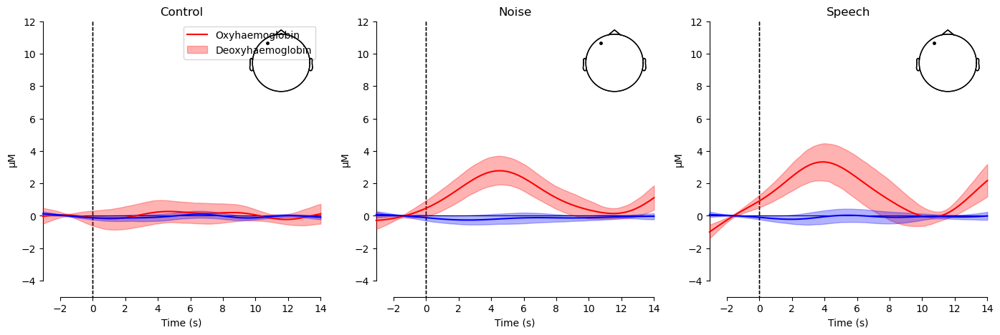

Optode: S2D1; Number of sessions: 45


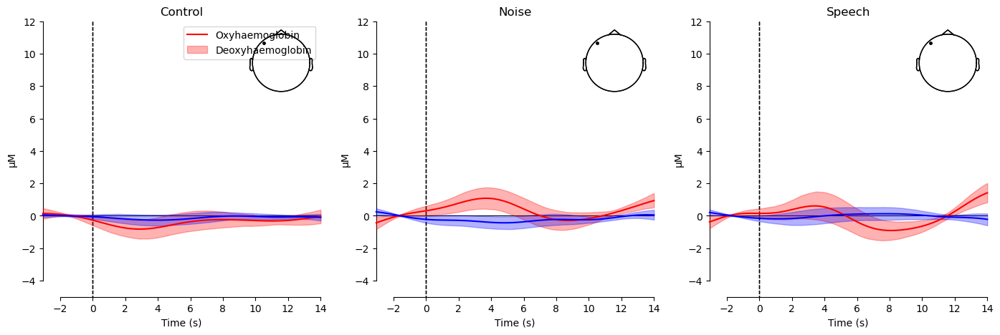

Optode: S3D1; Number of sessions: 45


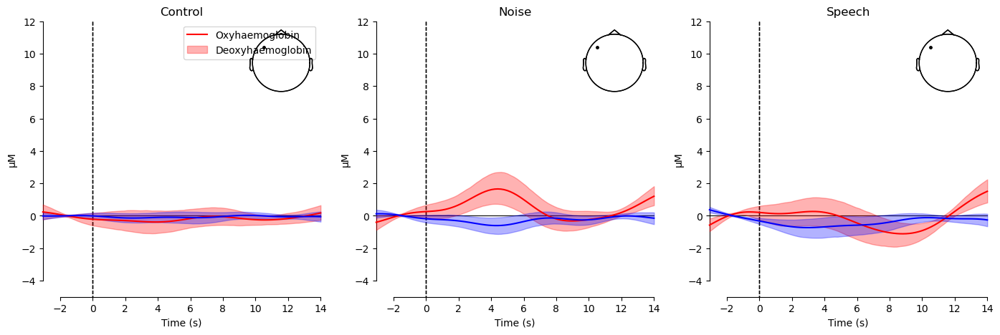

Optode: S3D2; Number of sessions: 44


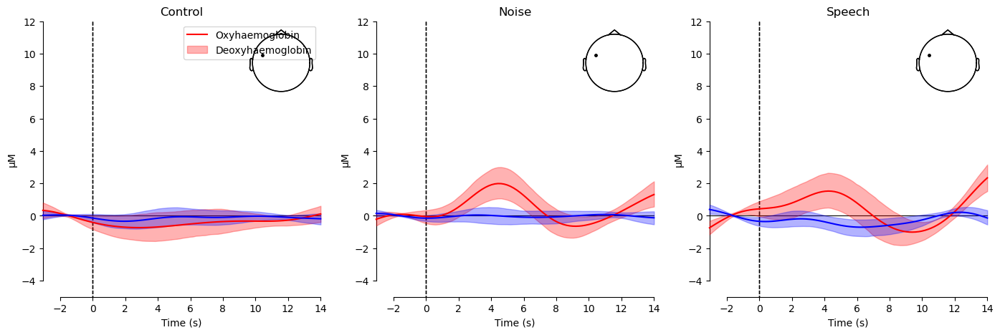

Optode: S12D1; Number of sessions: 45


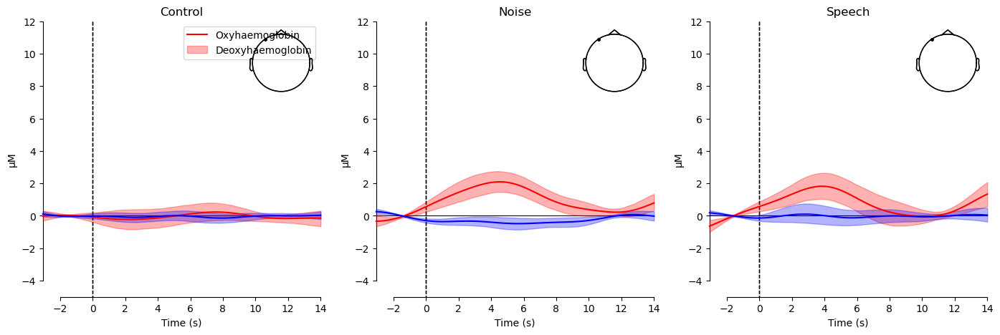

In [82]:
# Specify the figure size and limits per chromophore

Left_hemisphere_optodes = ["S4D2", "S4D3", "S5D2", "S5D3", "S5D4", "S5D5"]
Right_hemisphere_optodes = ["S10D9", "S10D10", "S10D11", "S10D12", "S11D11", "S11D12"]
Back_optodes = ["S6D6", "S6D8", "S7D6", "S7D7", "S7D8", "S8D7", "S8D8", "S9D8"]
Front_optodes = ["S1D1", "S2D1", "S3D1", "S3D2", "S12D1"]

for optode in Front_optodes:
    all_evokeds = all_evokeds_dict[optode]
    print(f"Optode: {optode}; Number of sessions: {len(all_evokeds['Control'])}")
    fig, axes = plt.subplots(nrows=1, ncols=len(all_evokeds), figsize=(17, 5))
    lims = dict(hbo=[-5, 12], hbr=[-5, 12])

    for pick, color in zip(["hbo", "hbr"], ["r", "b"]):
        for idx, evoked in enumerate(all_evokeds):
            plot_compare_evokeds(
                {evoked: all_evokeds[evoked]},
                combine= None,
                picks=pick,
                axes=axes[idx],
                show=False,
                colors=[color],
                legend=False,
                ylim=lims,
                #ci=0.95,
                show_sensors=True
                
            )
            axes[idx].set_title(f"{evoked}")
    axes[0].legend(["Oxyhaemoglobin", "Deoxyhaemoglobin"])
    # show the figure
    plt.show()
    
    
    

Optode: S4D2; Number of sessions: 41


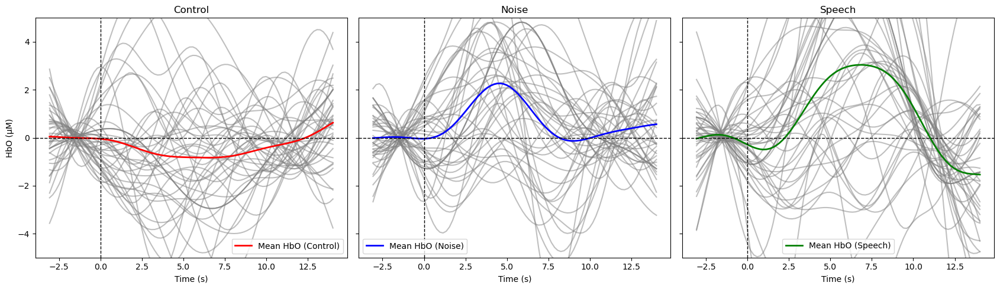

Optode: S6D6; Number of sessions: 28


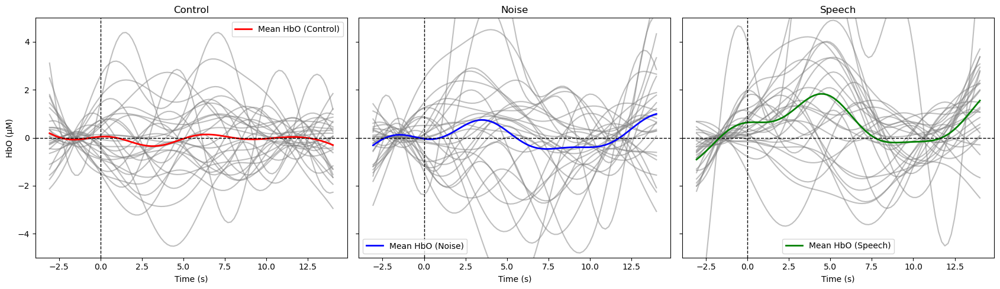

Optode: S4D3; Number of sessions: 41


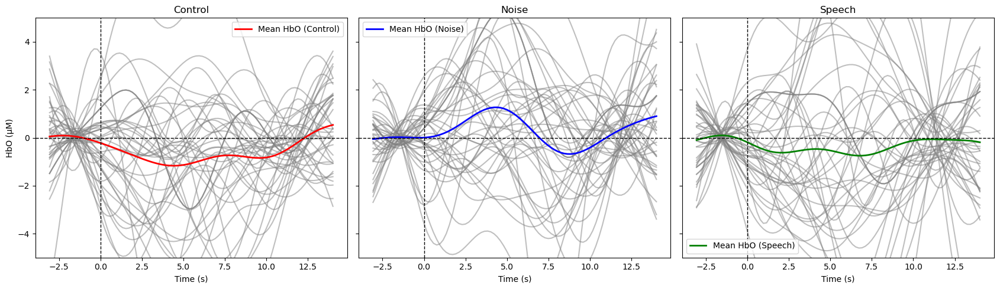

Optode: S5D2; Number of sessions: 41


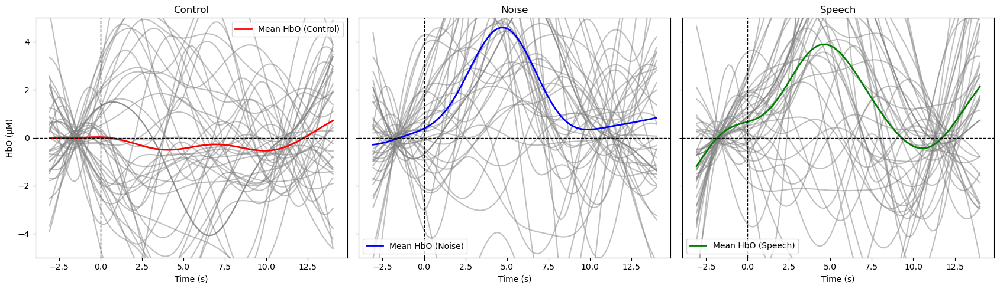

Optode: S5D3; Number of sessions: 32


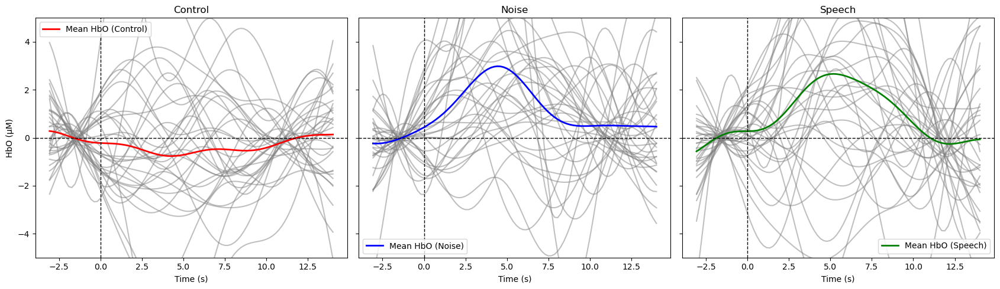

Optode: S5D4; Number of sessions: 41


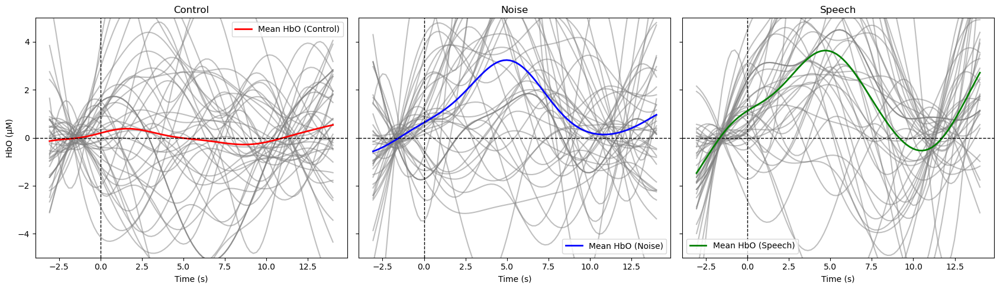

Optode: S5D5; Number of sessions: 38


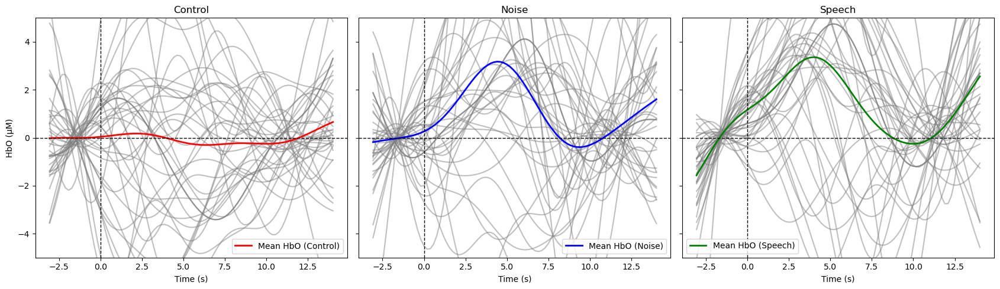

Optode: S10D9; Number of sessions: 37


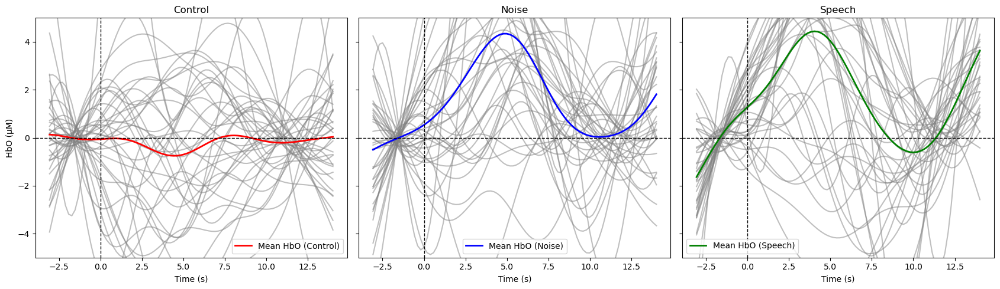

Optode: S10D10; Number of sessions: 39


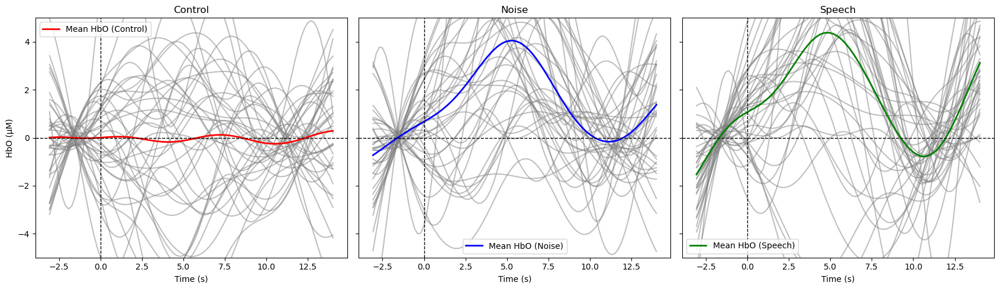

Optode: S10D11; Number of sessions: 40


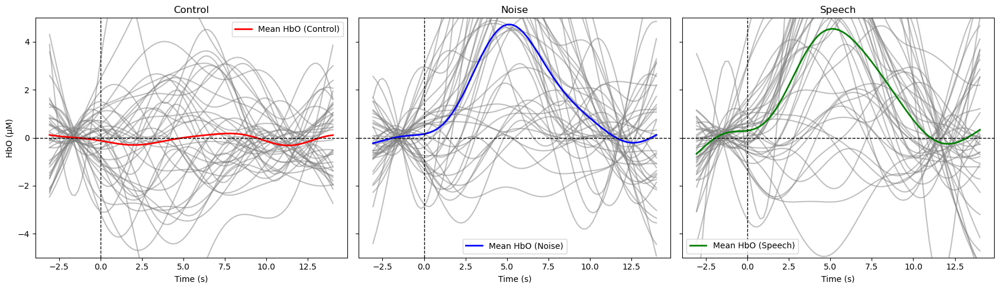

Optode: S10D12; Number of sessions: 41


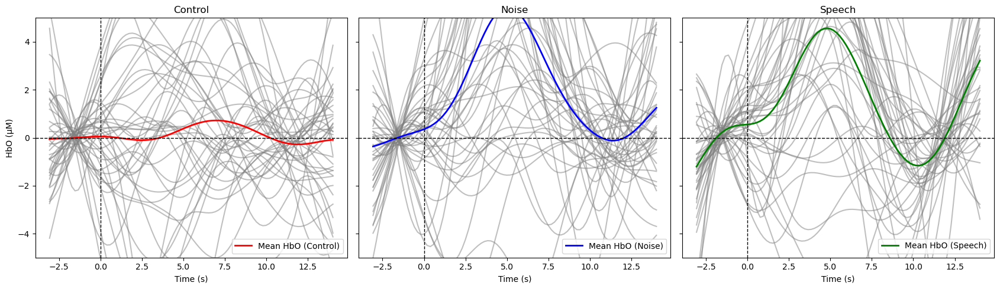

Optode: S11D11; Number of sessions: 45


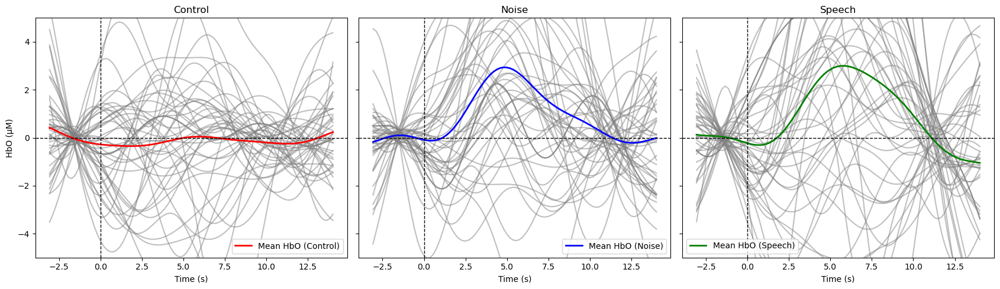

Optode: S11D12; Number of sessions: 45


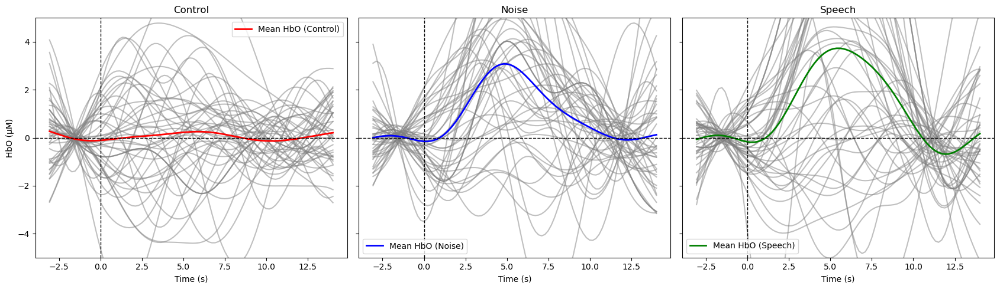

Optode: S6D8; Number of sessions: 35


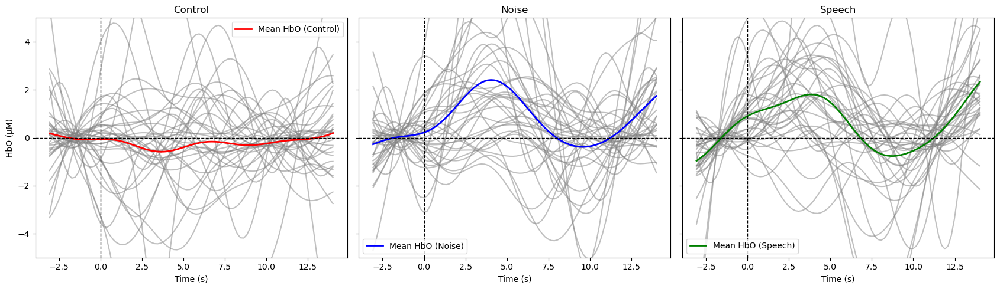

Optode: S7D6; Number of sessions: 21


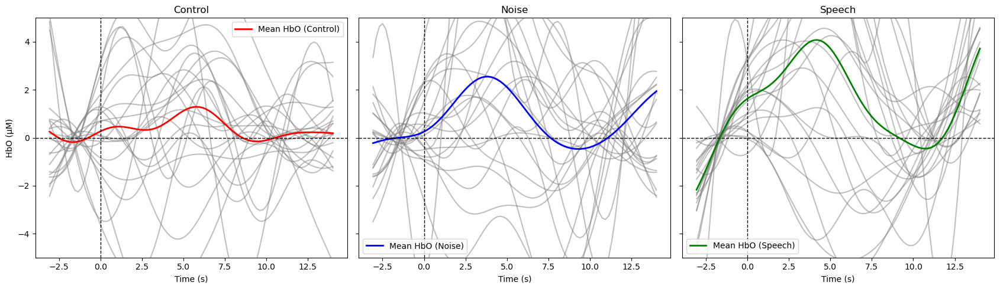

Optode: S7D7; Number of sessions: 33


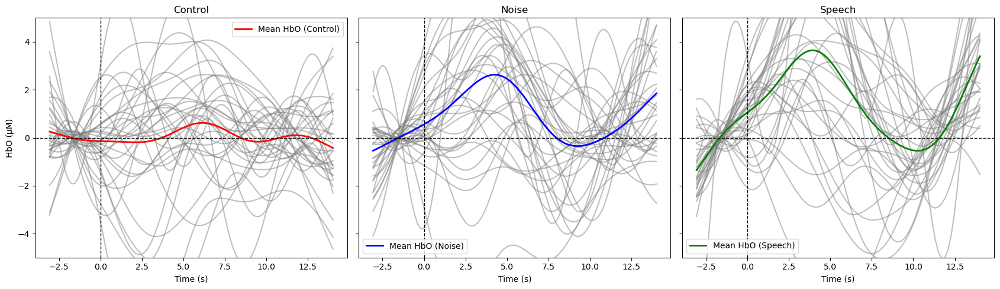

Optode: S7D8; Number of sessions: 18


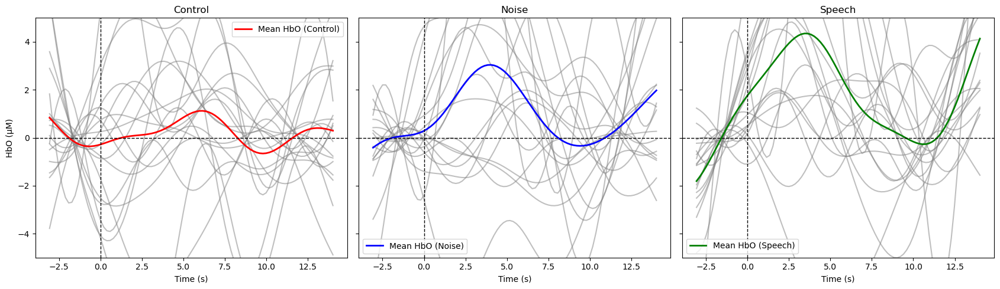

Optode: S8D7; Number of sessions: 33


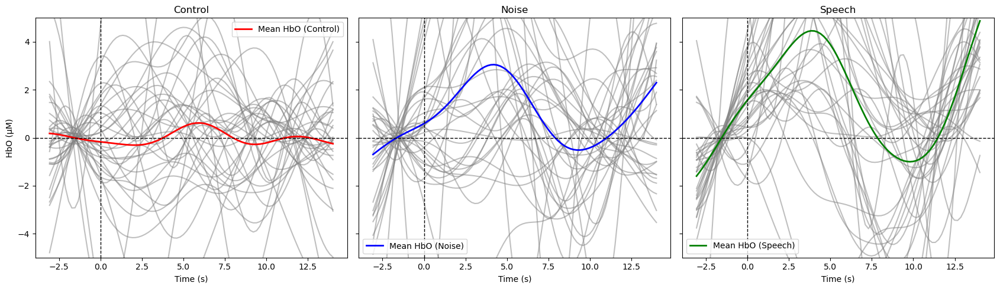

Optode: S8D8; Number of sessions: 35


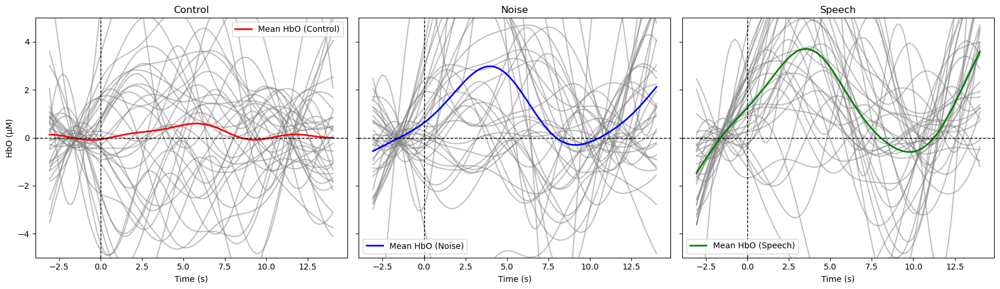

Optode: S9D8; Number of sessions: 26


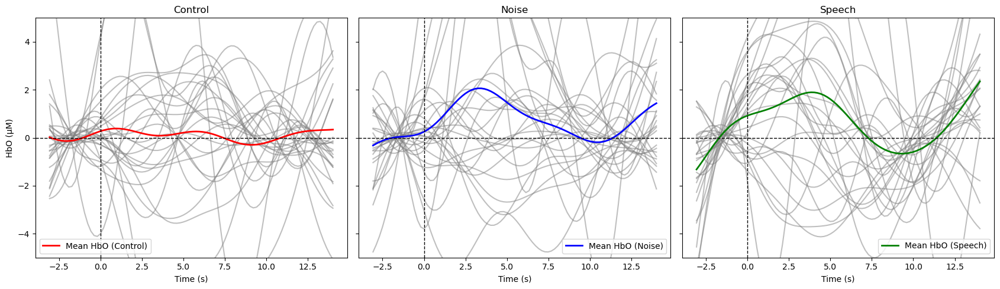

Optode: S1D1; Number of sessions: 45


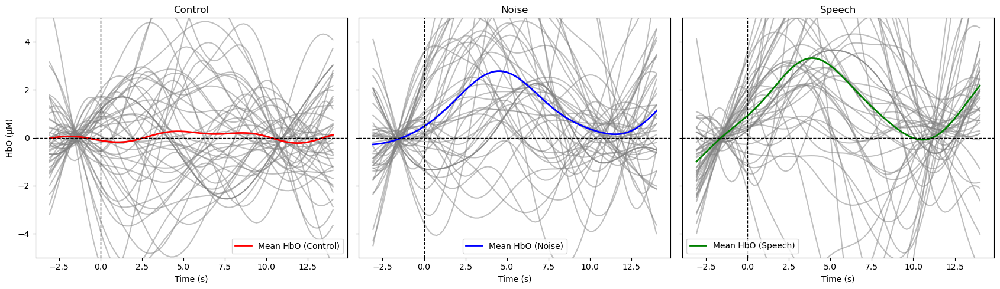

Optode: S2D1; Number of sessions: 45


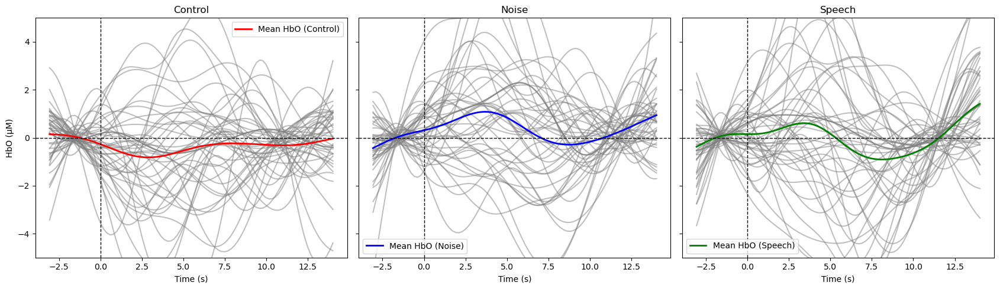

Optode: S3D1; Number of sessions: 45


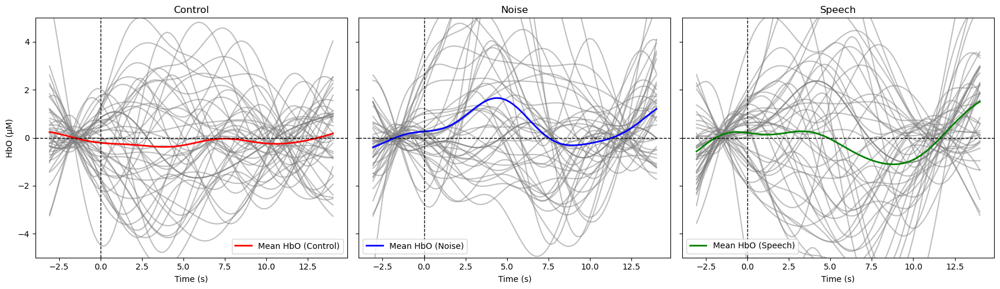

Optode: S3D2; Number of sessions: 44


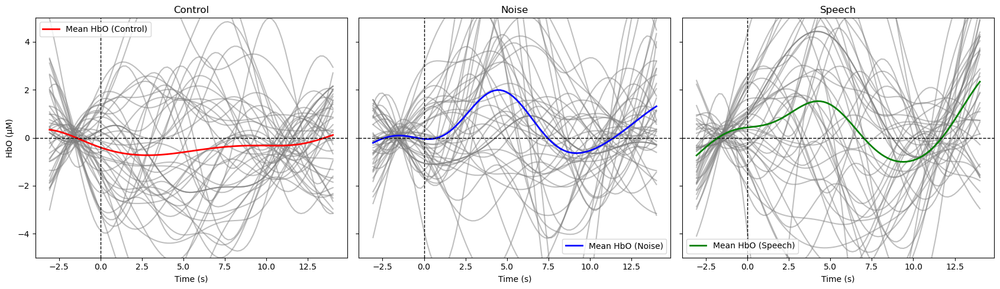

Optode: S12D1; Number of sessions: 45


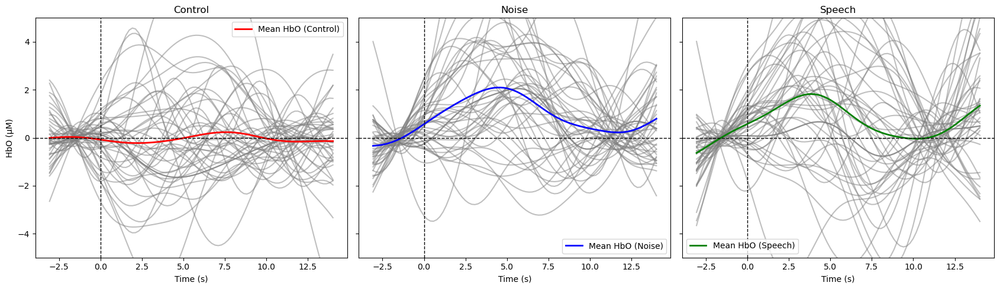

In [75]:

# correction
# Define colors for each condition
condition_colors = ["red", "blue", "green"]  # Adjust as needed

for optode in optodes:
    all_evokeds = all_evokeds_dict[optode]
    print(f"Optode: {optode}; Number of sessions: {len(all_evokeds['Control'])}")
    # Create subplots with shared axes
    fig, axes = plt.subplots(nrows=1, ncols=len(all_evokeds), figsize=(17, 5), sharey=True, sharex=True)

    # Find global min/max for y-axis limits

    y_min, y_max = -5, 5

    # Iterate over each condition and plot
    for idx, (condition, evoked_list) in enumerate(all_evokeds.items()):
        ax = axes[idx]  # Select subplot
        color = condition_colors[idx]  # Assign color

        # Extract time points
        times = evoked_list[0].times

        # Extract only HbO data
        hbo_data = np.array([evoked.copy().pick("hbo").data for evoked in evoked_list])  # (n_participants, n_channels, n_times)

        # Compute a dictionary of means across participants should be size n_participants x n_times
        mean_channels_all_part = np.zeros((len(hbo_data), hbo_data[0].shape[1]))  # (n_participants, n_times)
        for i in range(len(hbo_data)):
            mean_channels_all_part[i, :]= np.mean(hbo_data[i], axis=0)  # (n_channels, n_times)
            
        # Now we calculate the mean across participants   
        mean_hbo = np.mean(mean_channels_all_part, axis=0)  # (1,n_times)

        # Plot individual participants in light gray
        for i in range(len(hbo_data)):
            ax.plot(times, mean_channels_all_part[i,:]* 1e6, color="gray", alpha=0.5)

        # Plot the mean with a distinct color
        ax.plot(times, mean_hbo* 1e6, color=color, linewidth=2, label=f"Mean HbO ({condition})")

        # Mark x=0 and y=0 axes in black
        ax.axhline(0, color='black', linewidth=1, linestyle='--')  # y=0 axis
        ax.axvline(0, color='black', linewidth=1, linestyle='--')  # x=0 axis

        # Formatting
        ax.set_title(condition)
        ax.set_xlabel("Time (s)")
        if idx == 0:  # Only label y-axis on first subplot
            ax.set_ylabel("HbO (μM)")
        ax.legend()

    # Set the same y-axis limits for all subplots
    plt.ylim(y_min, y_max)
    plt.tight_layout()
    plt.show()

Optode: S4D2; Number of sessions: 41


C:\Users\sarab\AppData\Local\Temp\ipykernel_27948\2824259610.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = cm.get_cmap("tab20", num_participants)


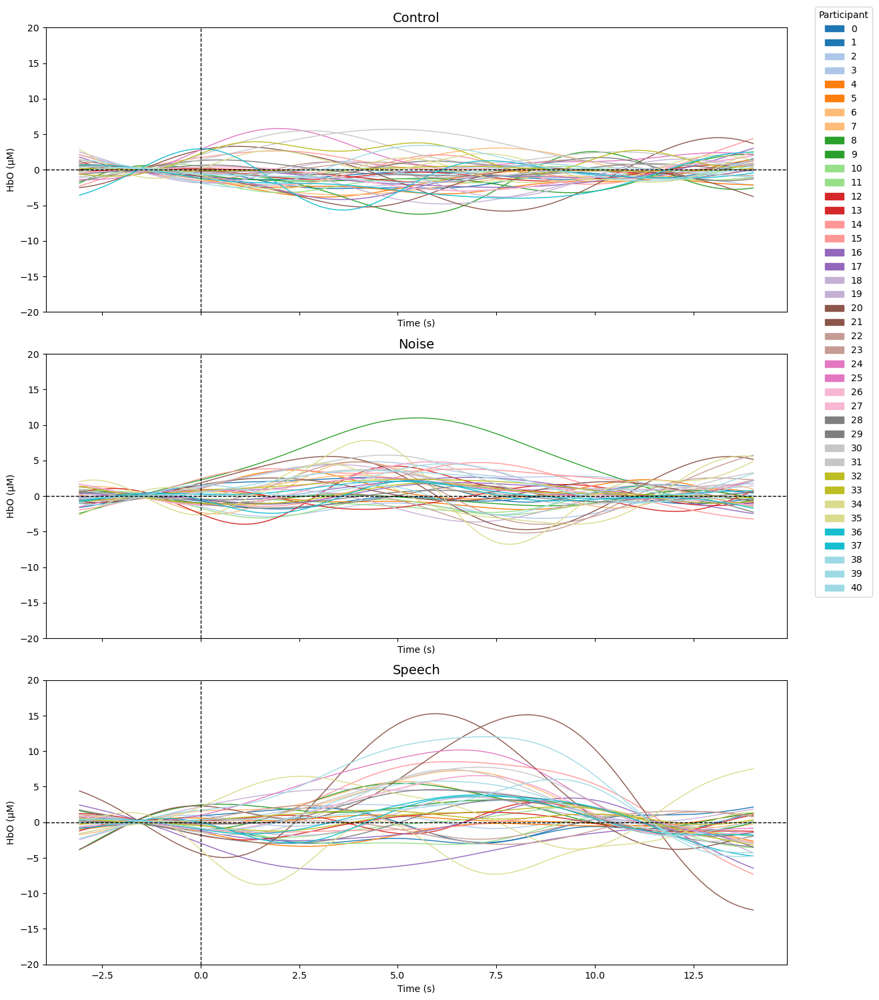

Optode: S6D6; Number of sessions: 28


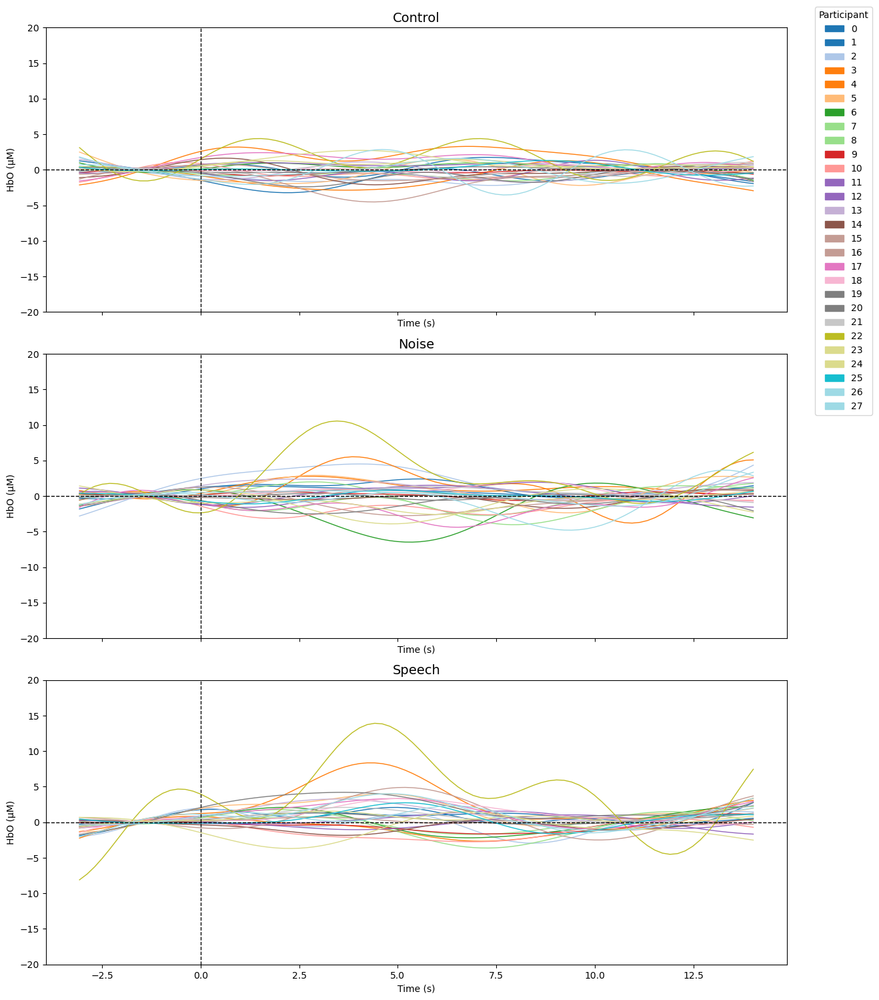

Optode: S4D3; Number of sessions: 41


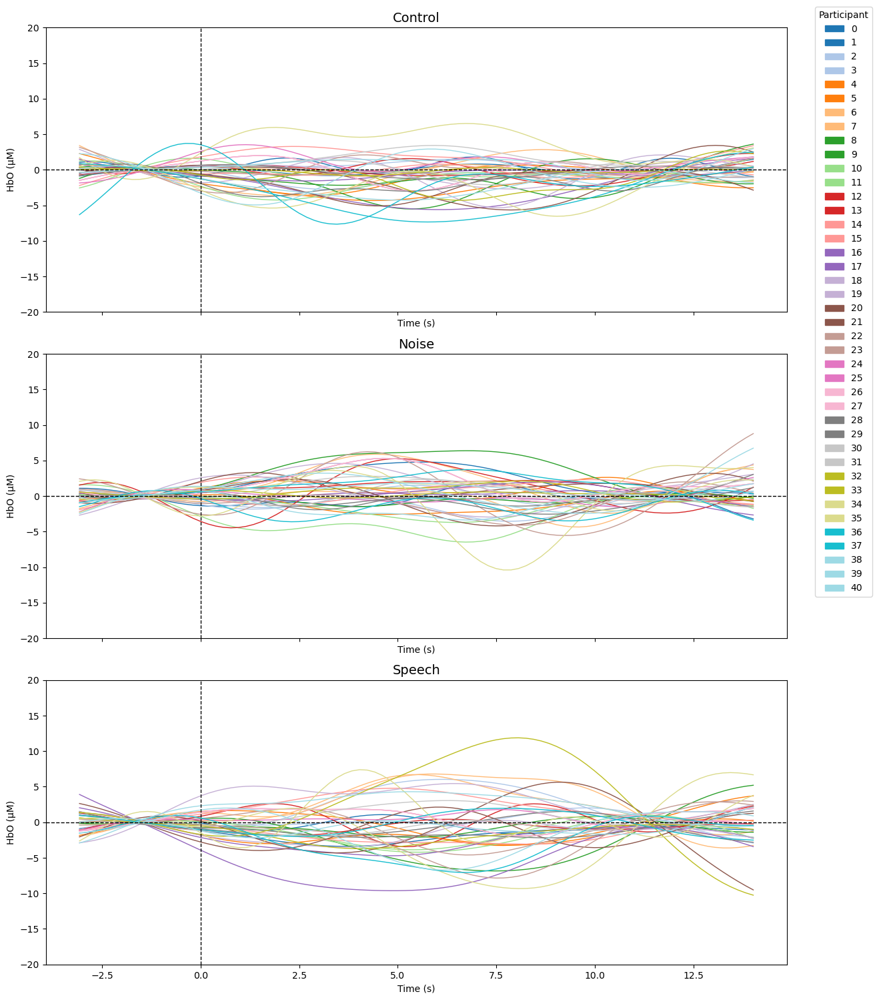

Optode: S5D2; Number of sessions: 41


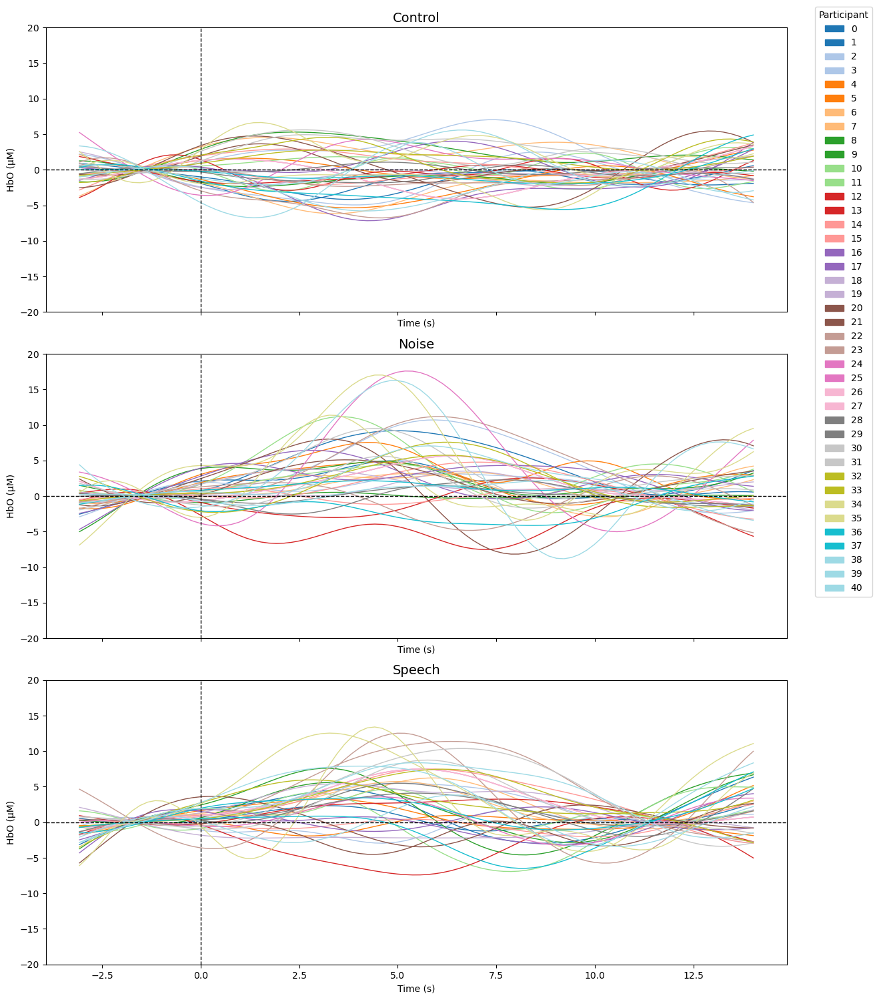

Optode: S5D3; Number of sessions: 32


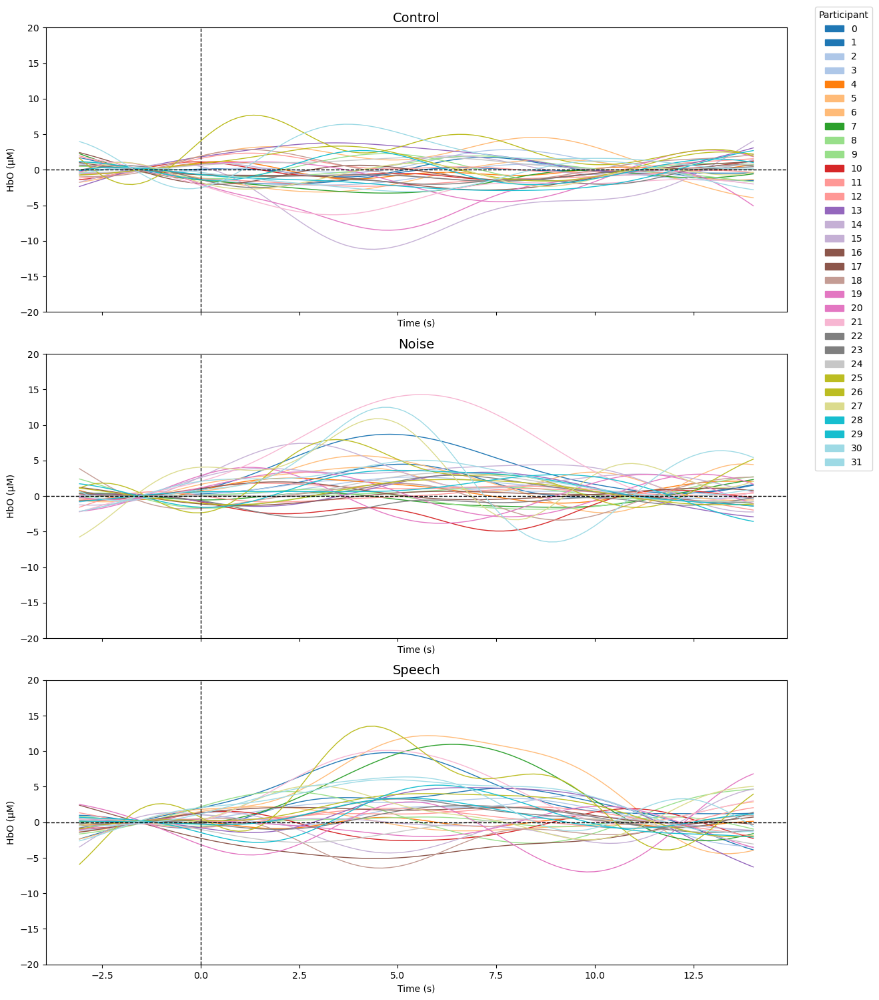

Optode: S5D4; Number of sessions: 41


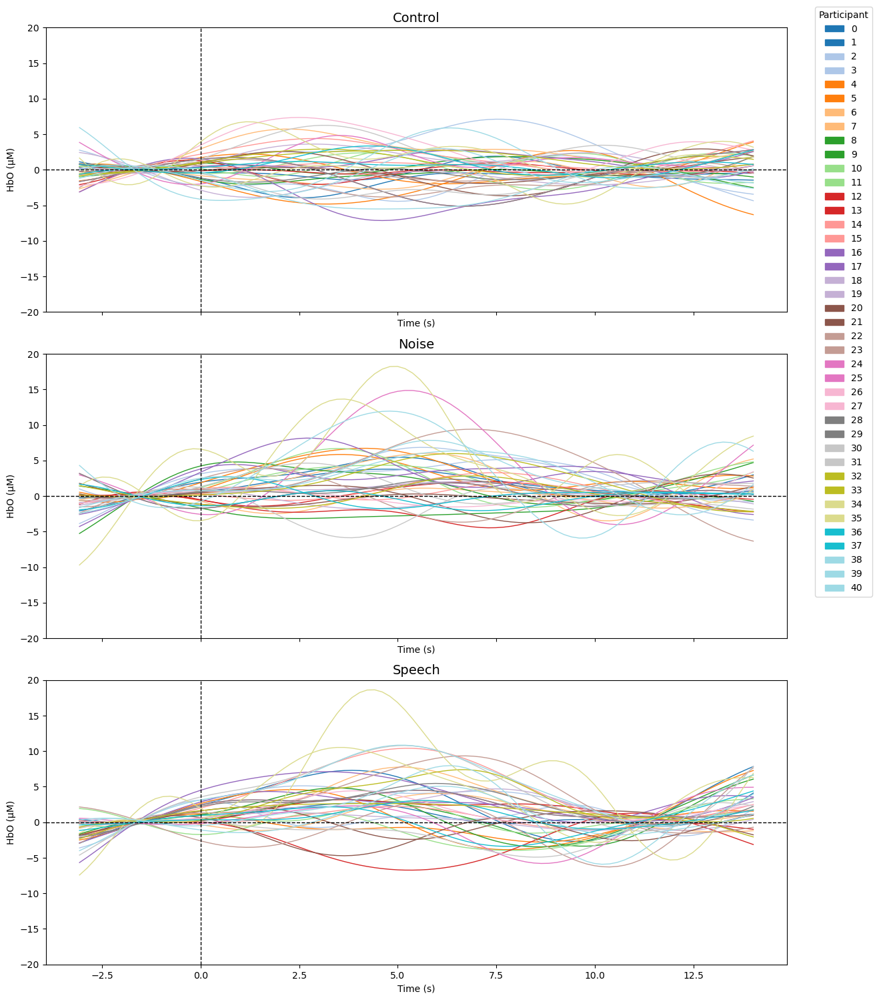

Optode: S5D5; Number of sessions: 38


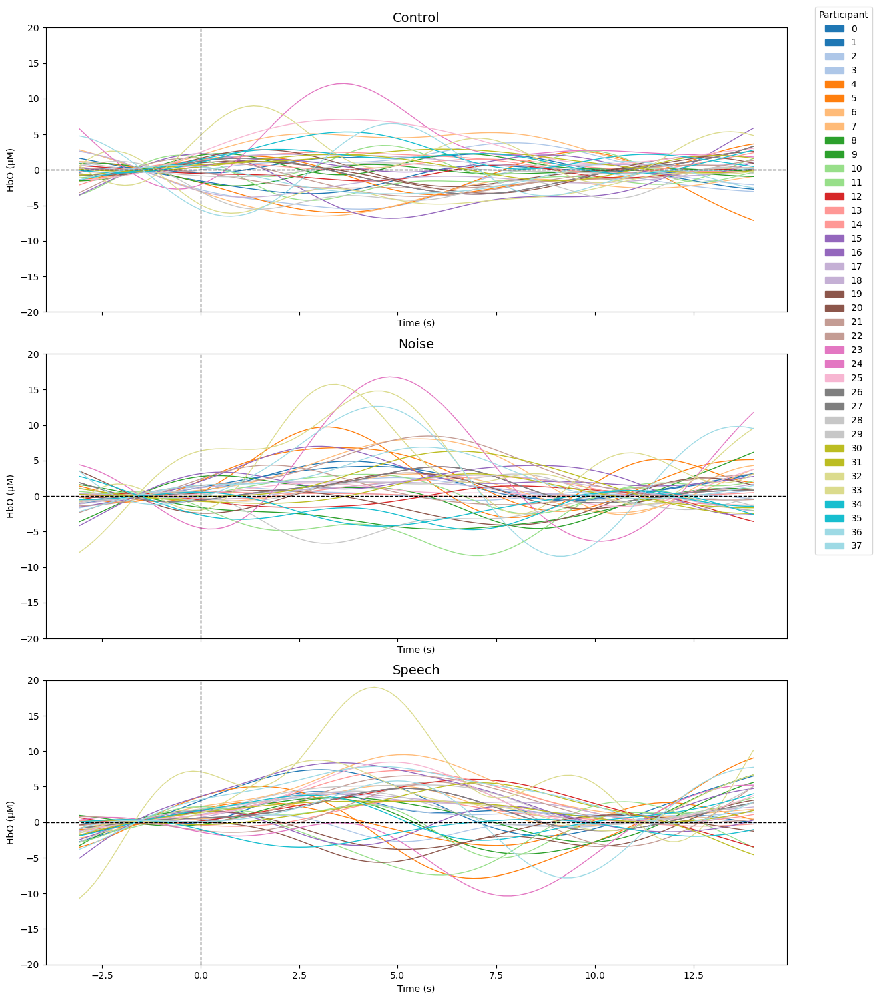

Optode: S10D9; Number of sessions: 37


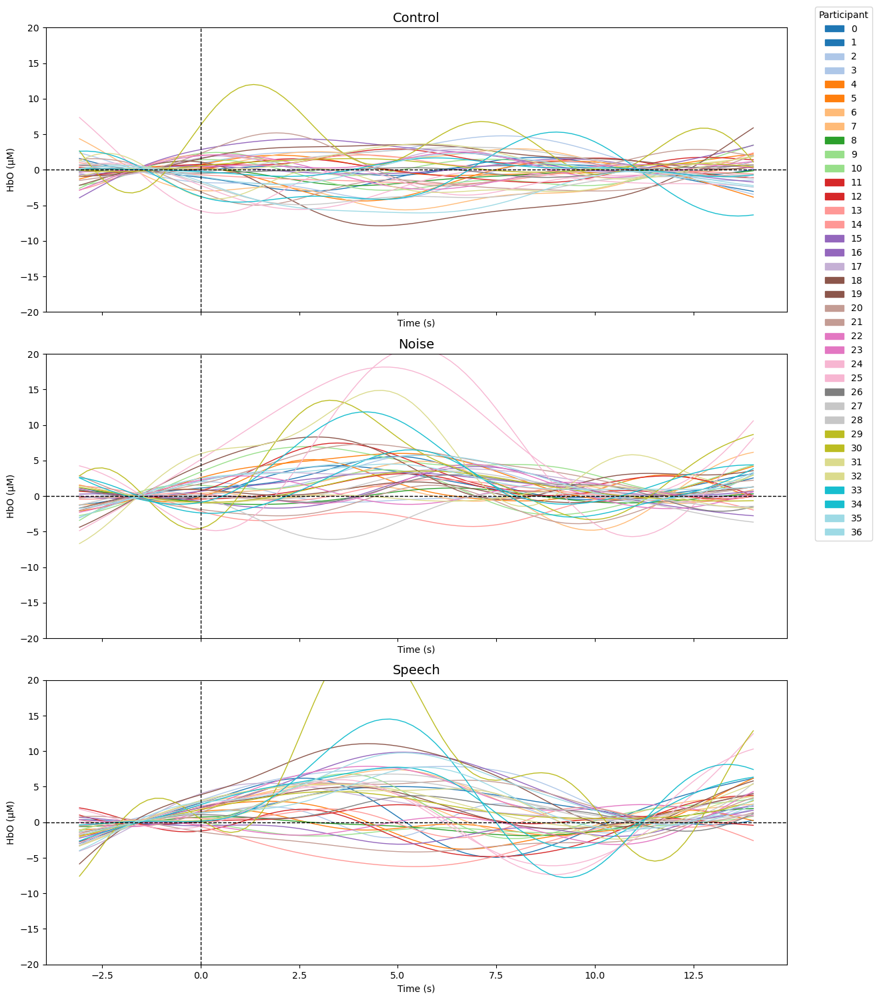

Optode: S10D10; Number of sessions: 39


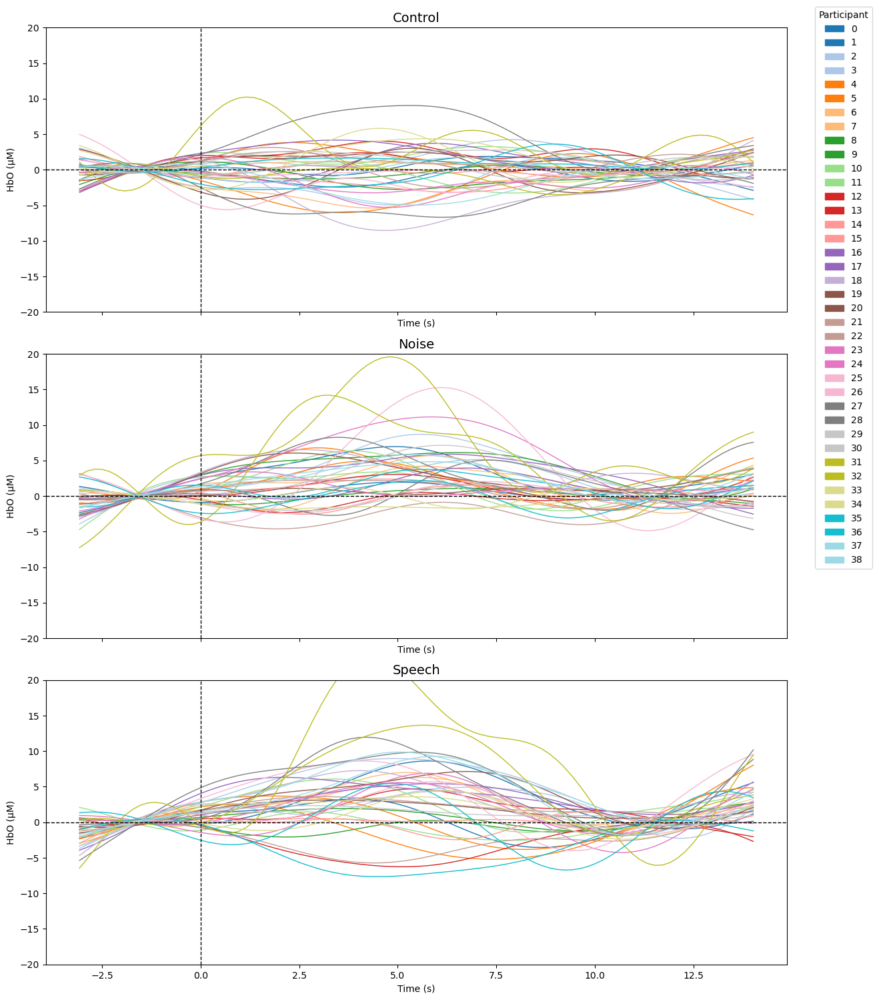

Optode: S10D11; Number of sessions: 40


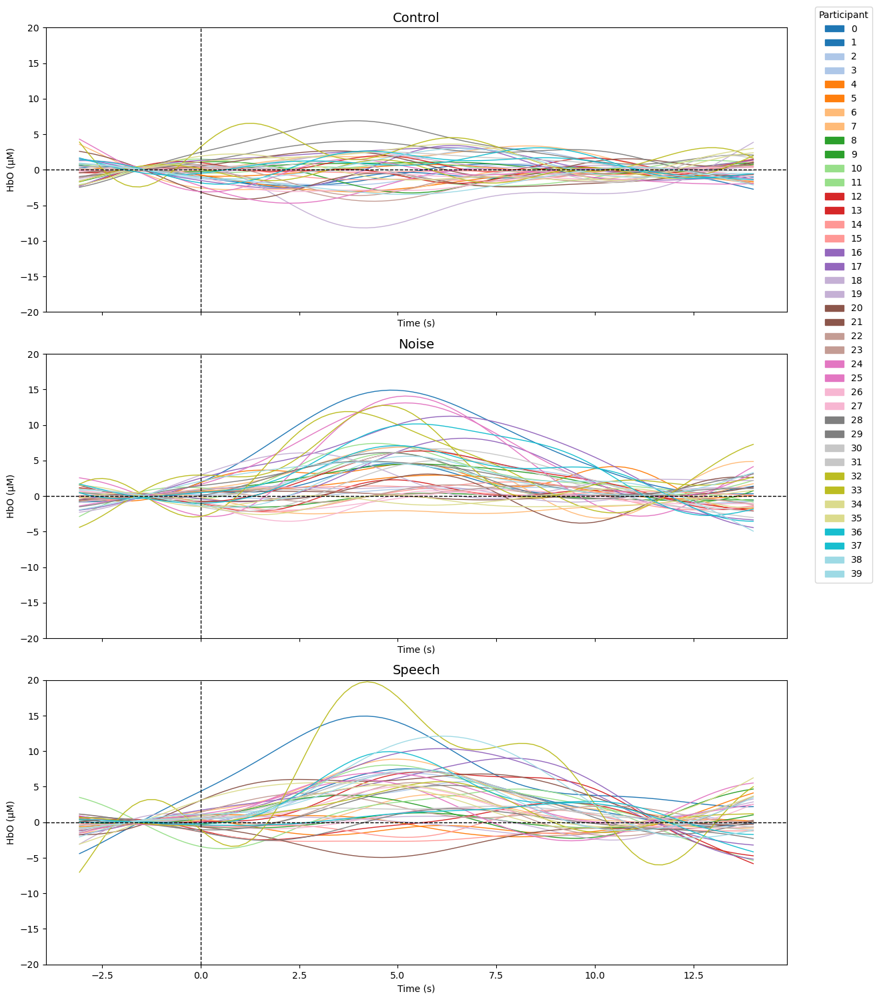

Optode: S10D12; Number of sessions: 41


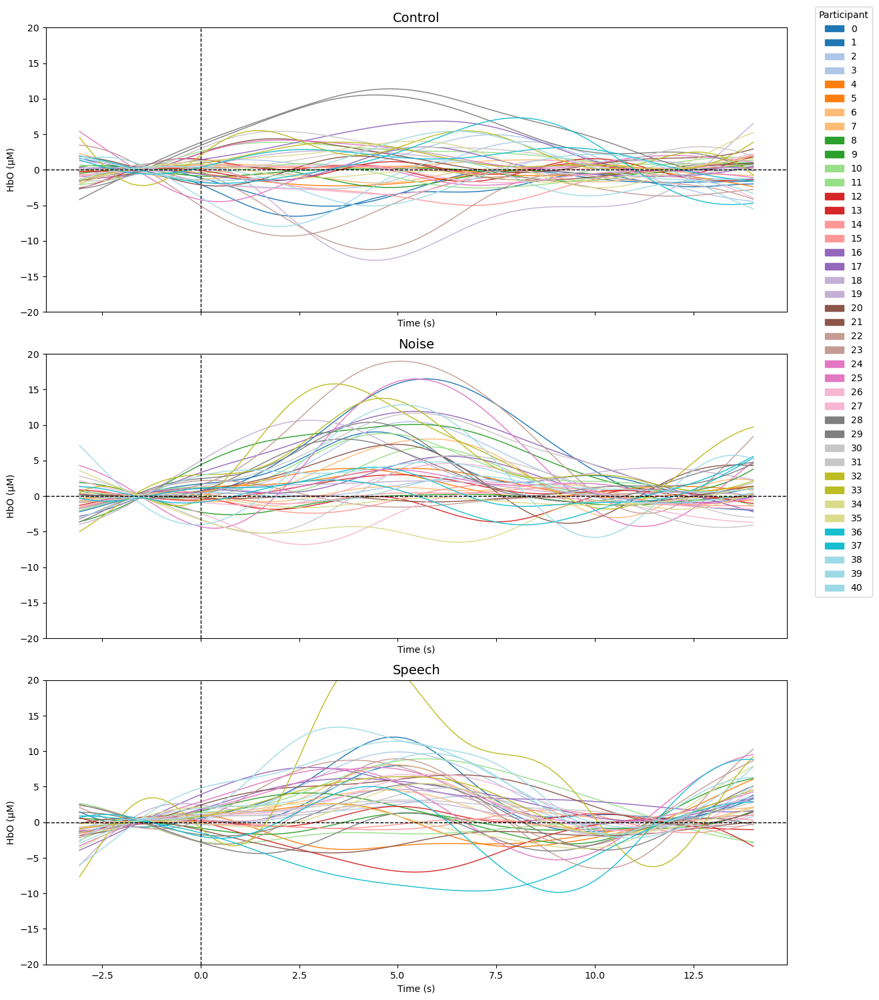

Optode: S11D11; Number of sessions: 45


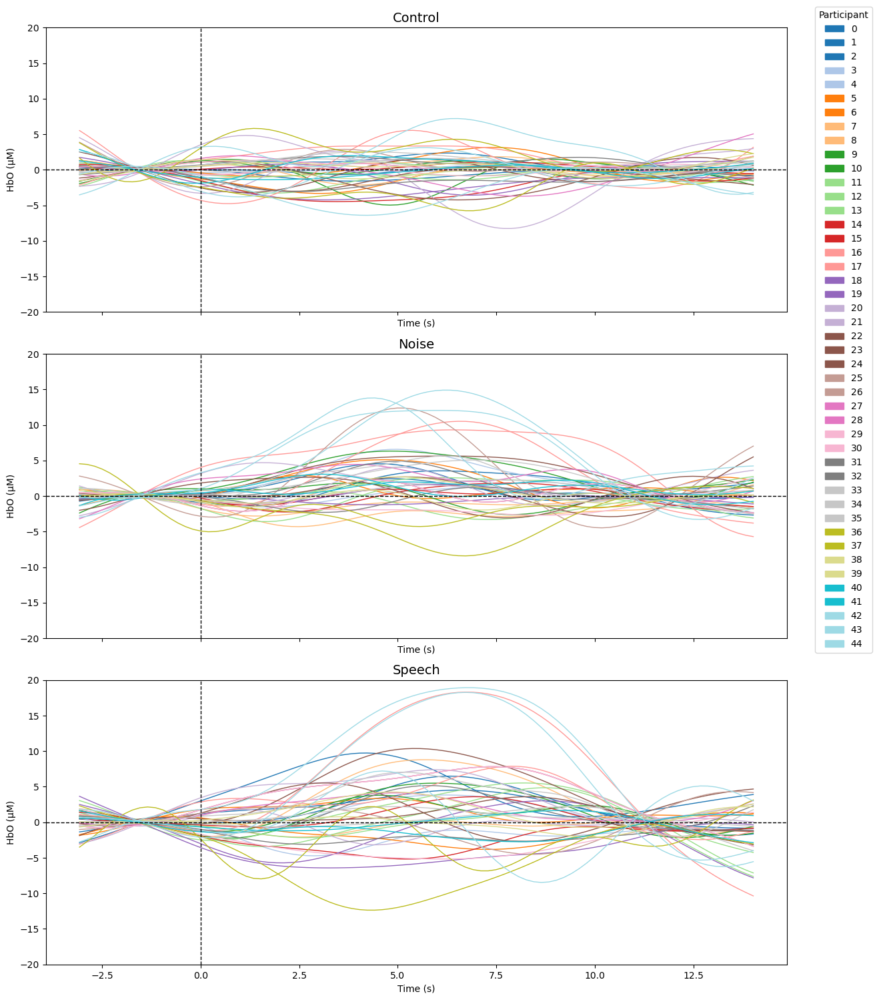

Optode: S11D12; Number of sessions: 45


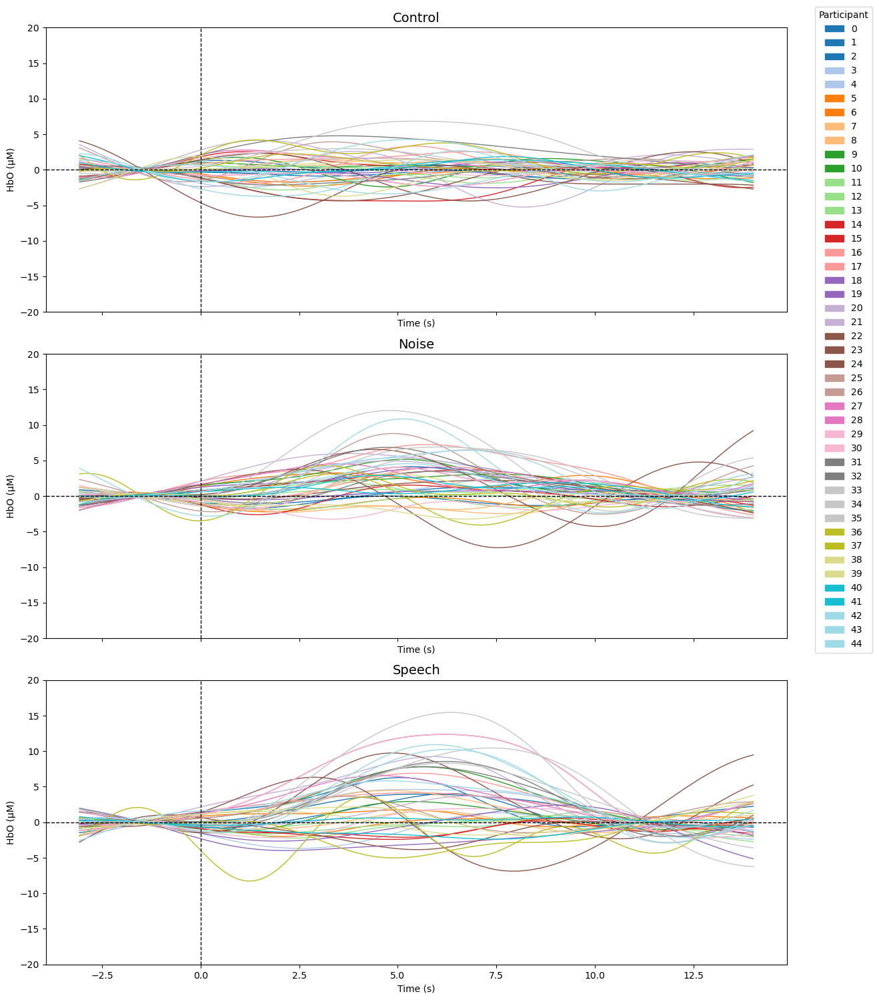

Optode: S6D8; Number of sessions: 35


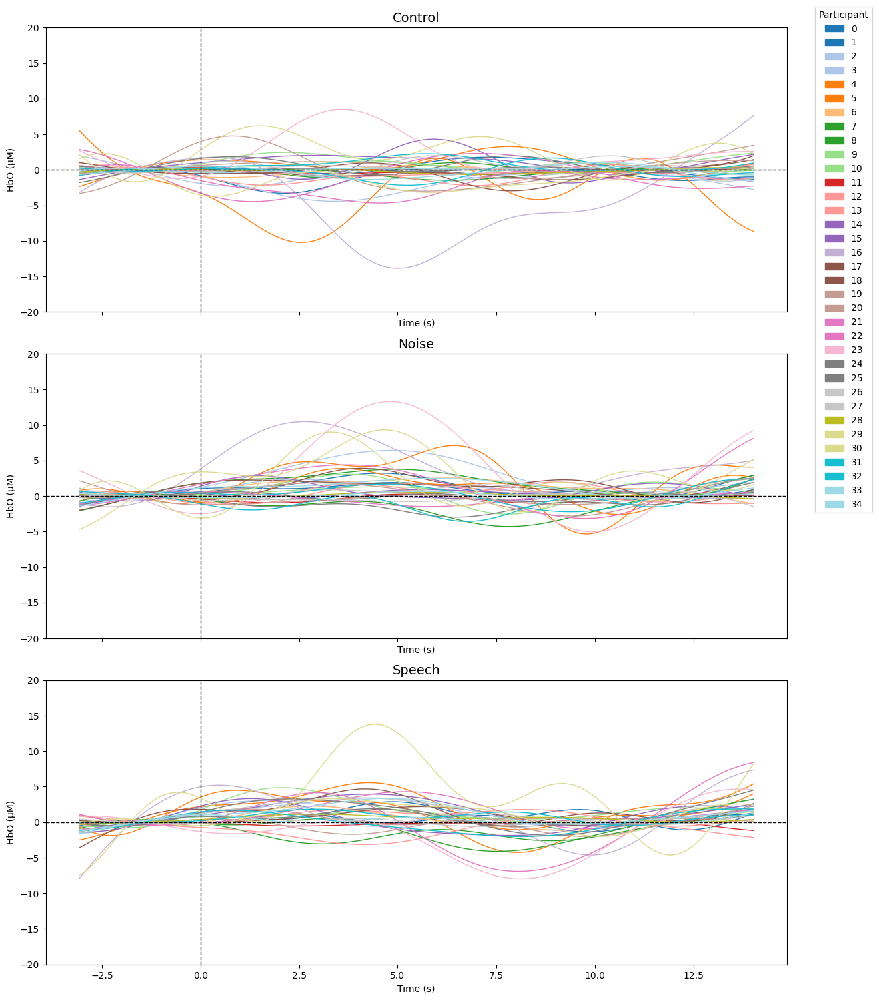

Optode: S7D6; Number of sessions: 21


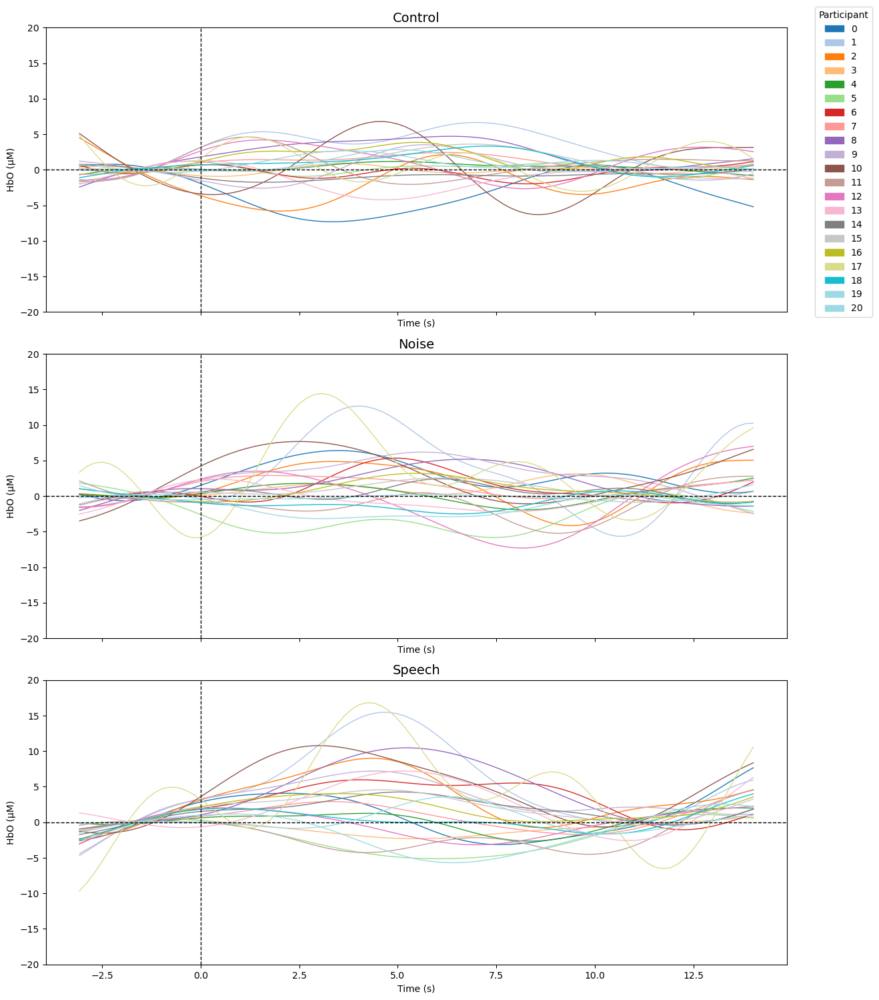

Optode: S7D7; Number of sessions: 33


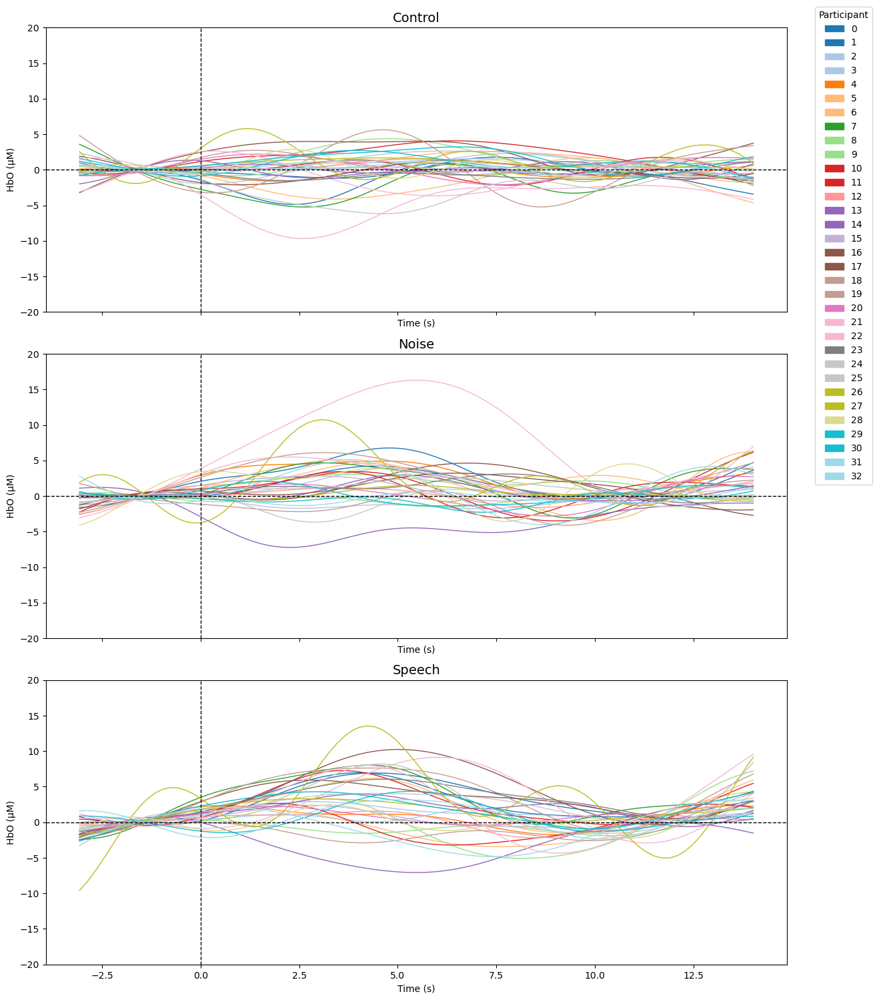

Optode: S7D8; Number of sessions: 18


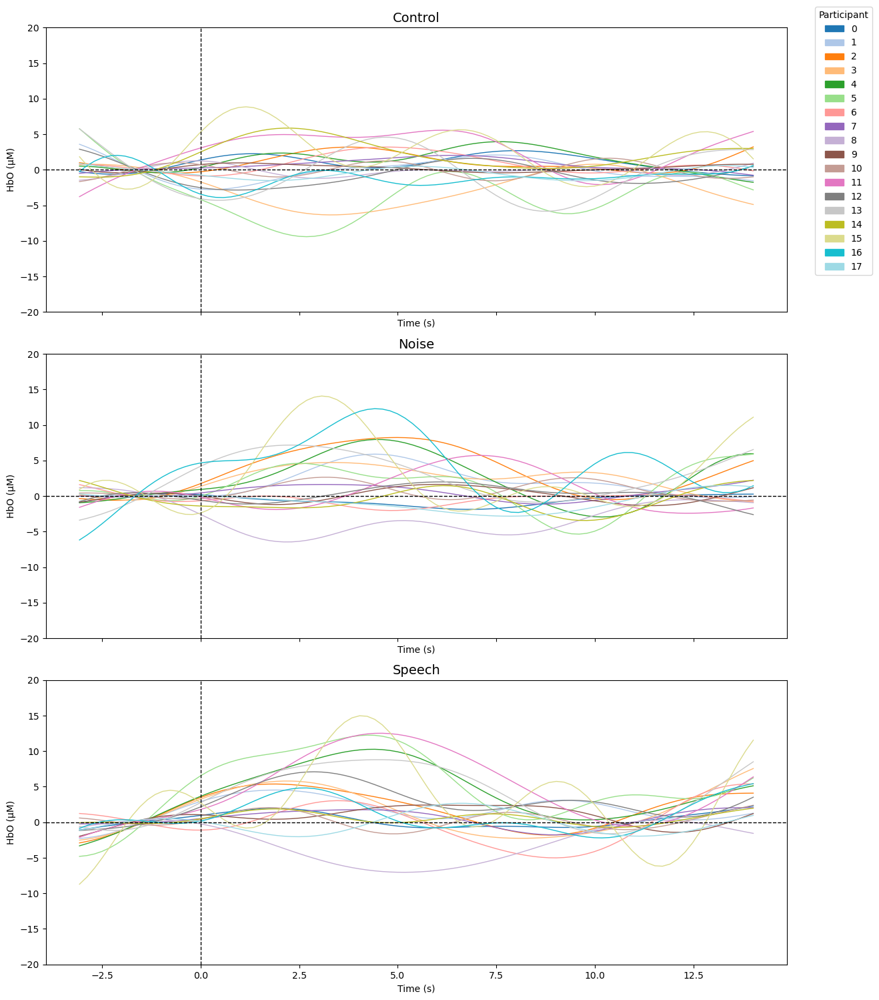

Optode: S8D7; Number of sessions: 33


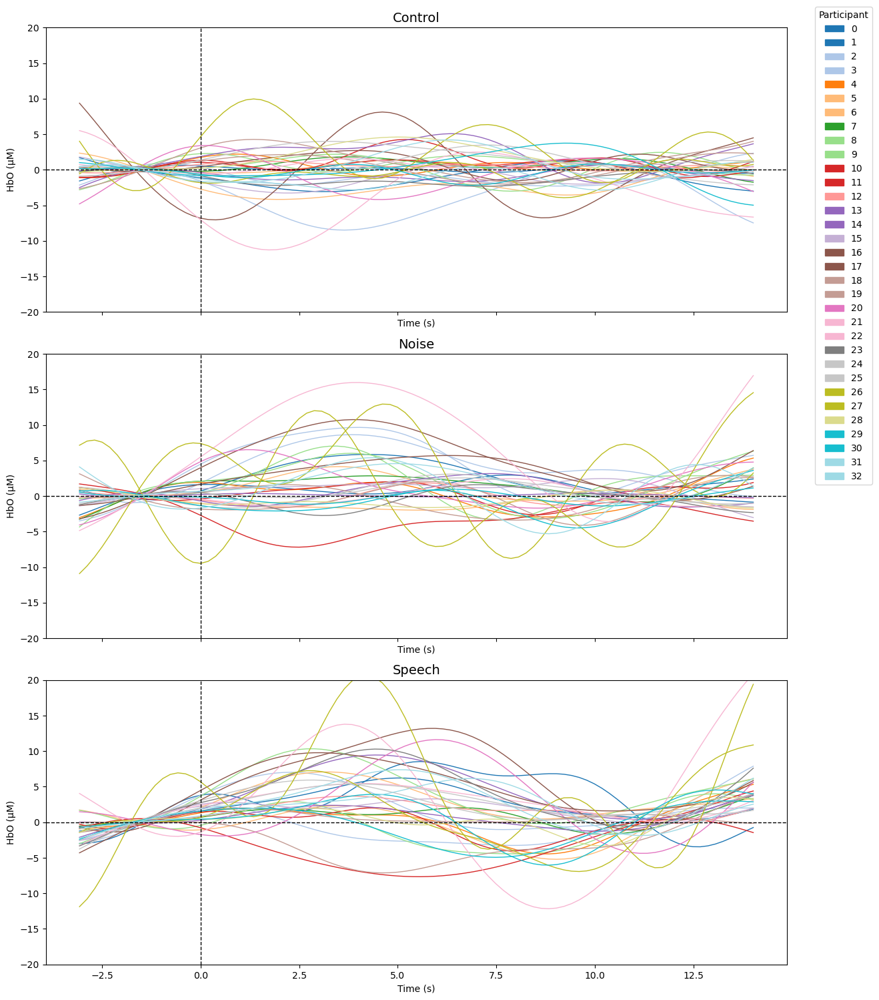

Optode: S8D8; Number of sessions: 35


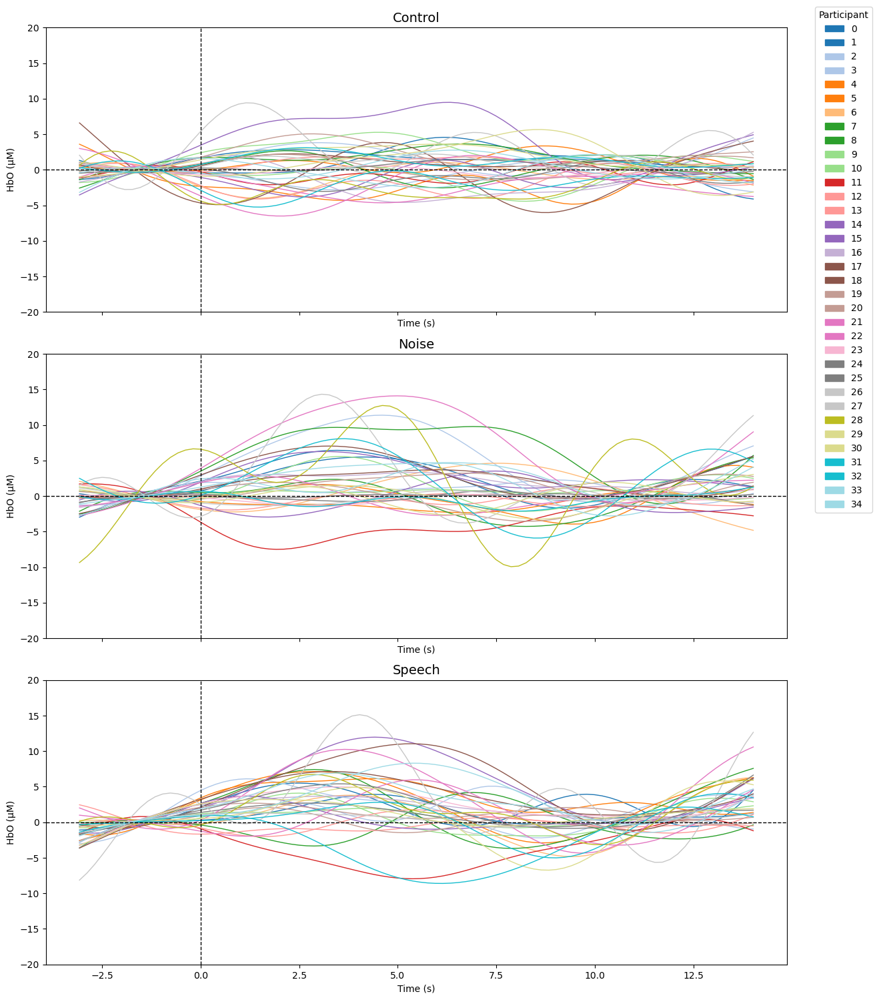

Optode: S9D8; Number of sessions: 26


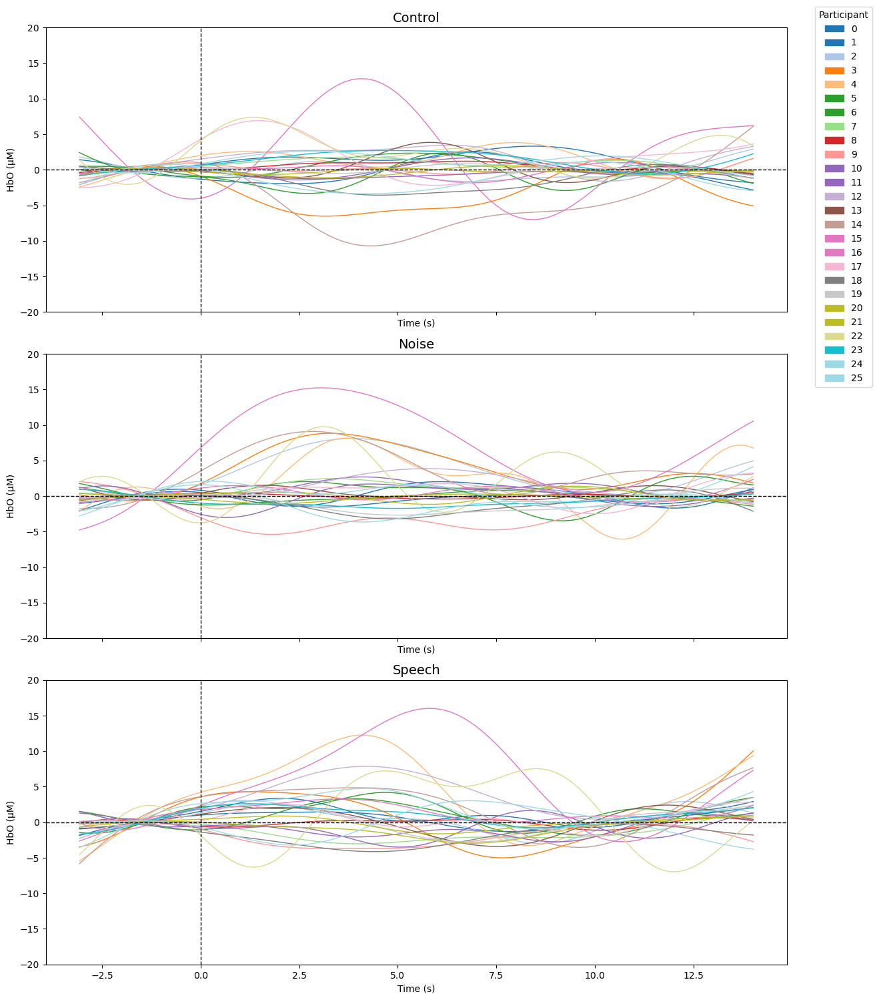

Optode: S1D1; Number of sessions: 45


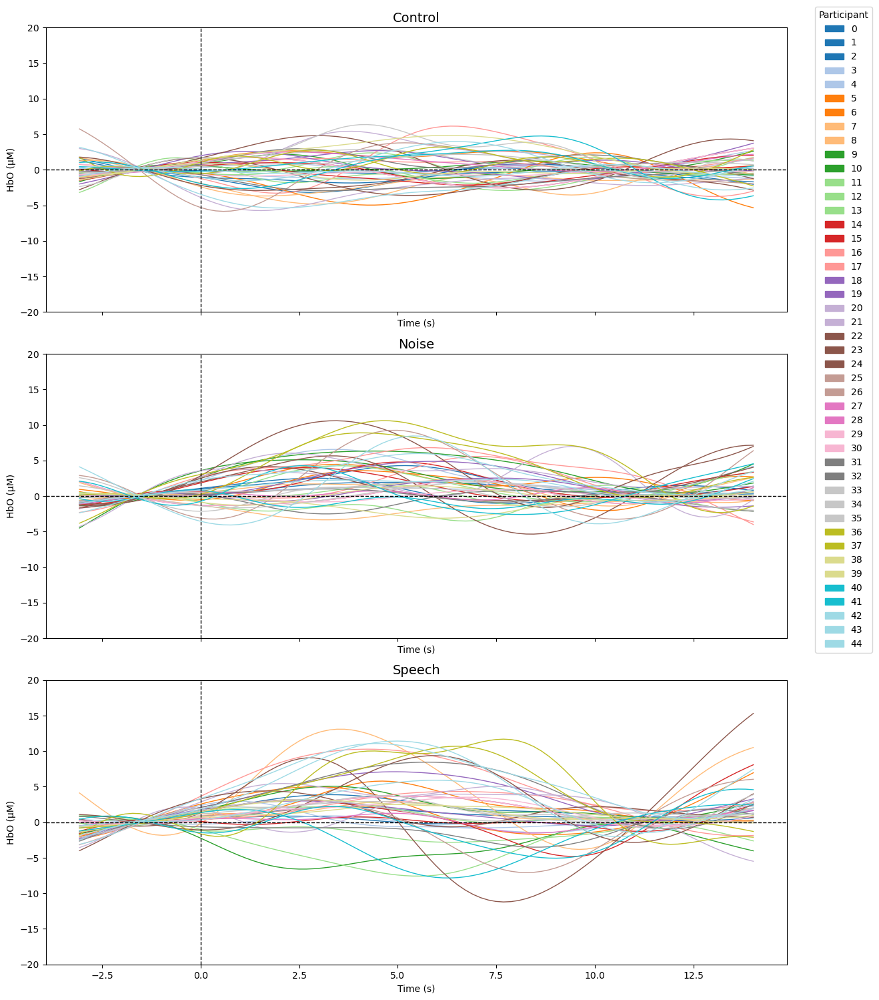

Optode: S2D1; Number of sessions: 45


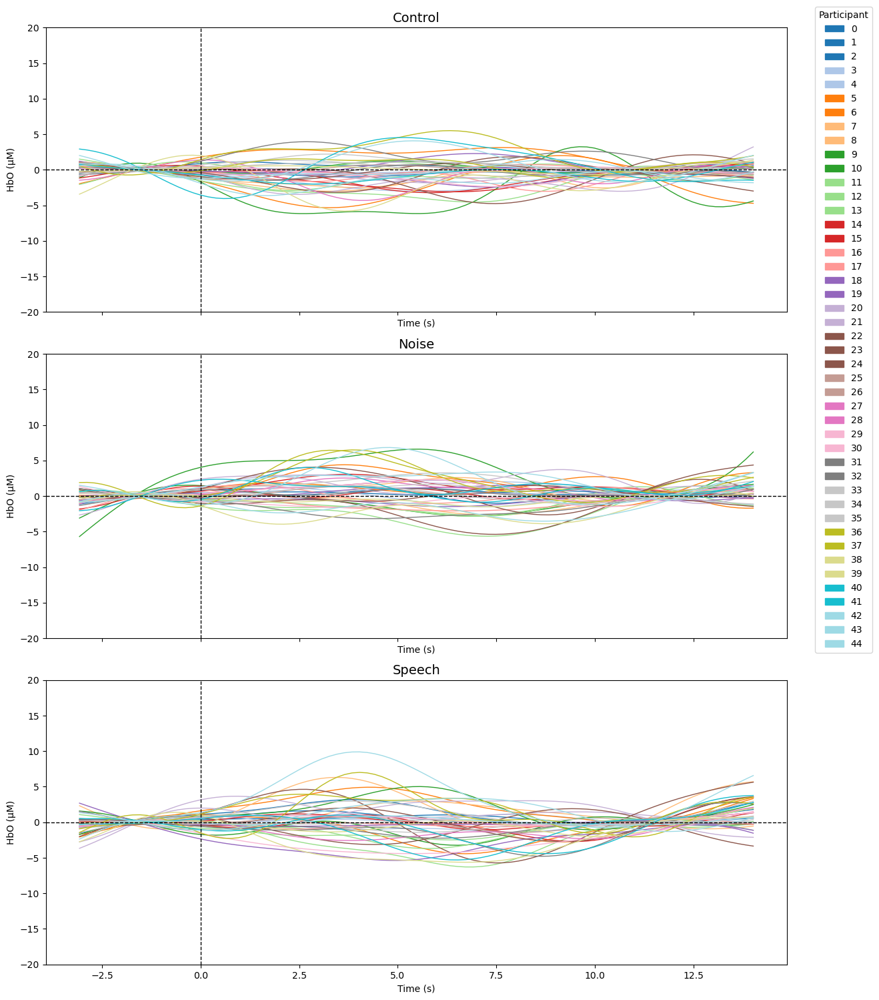

Optode: S3D1; Number of sessions: 45


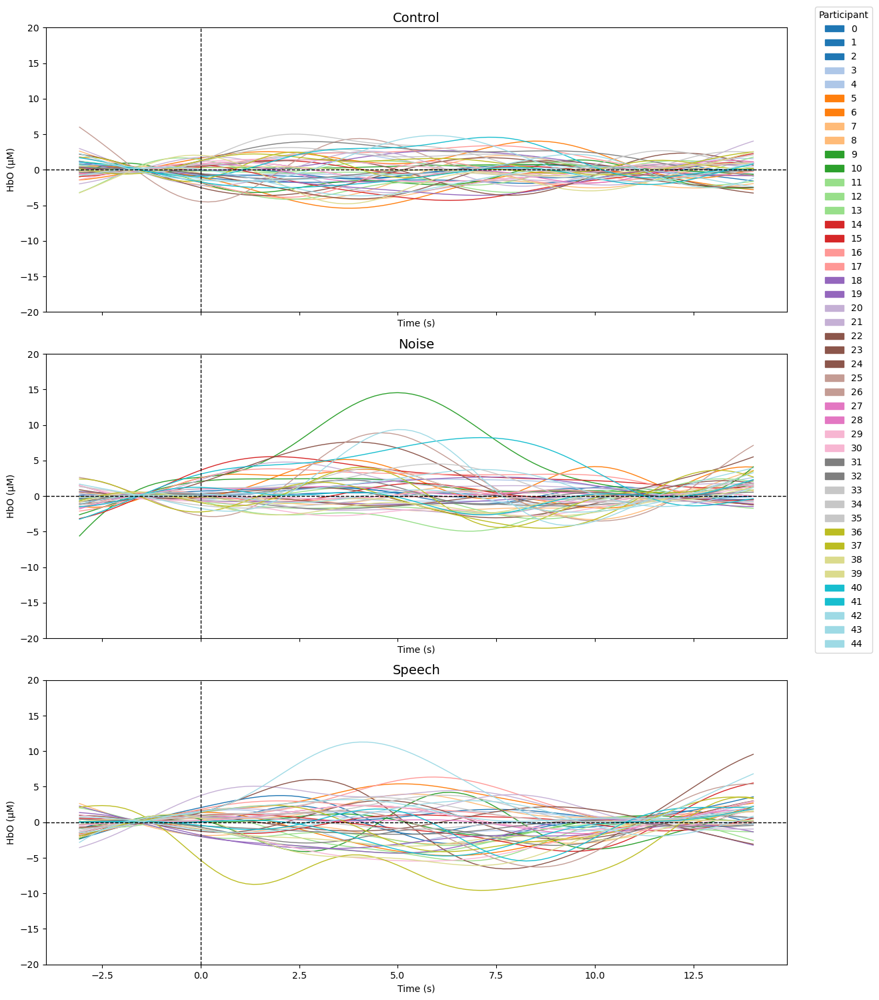

Optode: S3D2; Number of sessions: 44


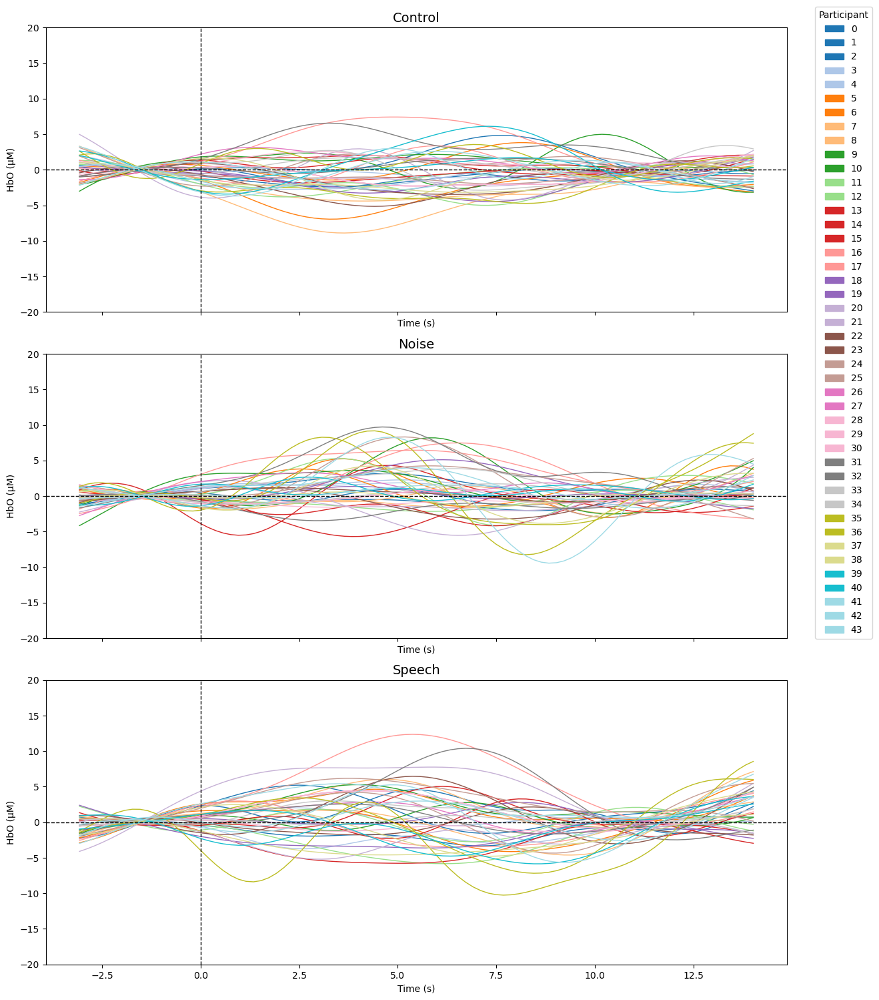

Optode: S12D1; Number of sessions: 45


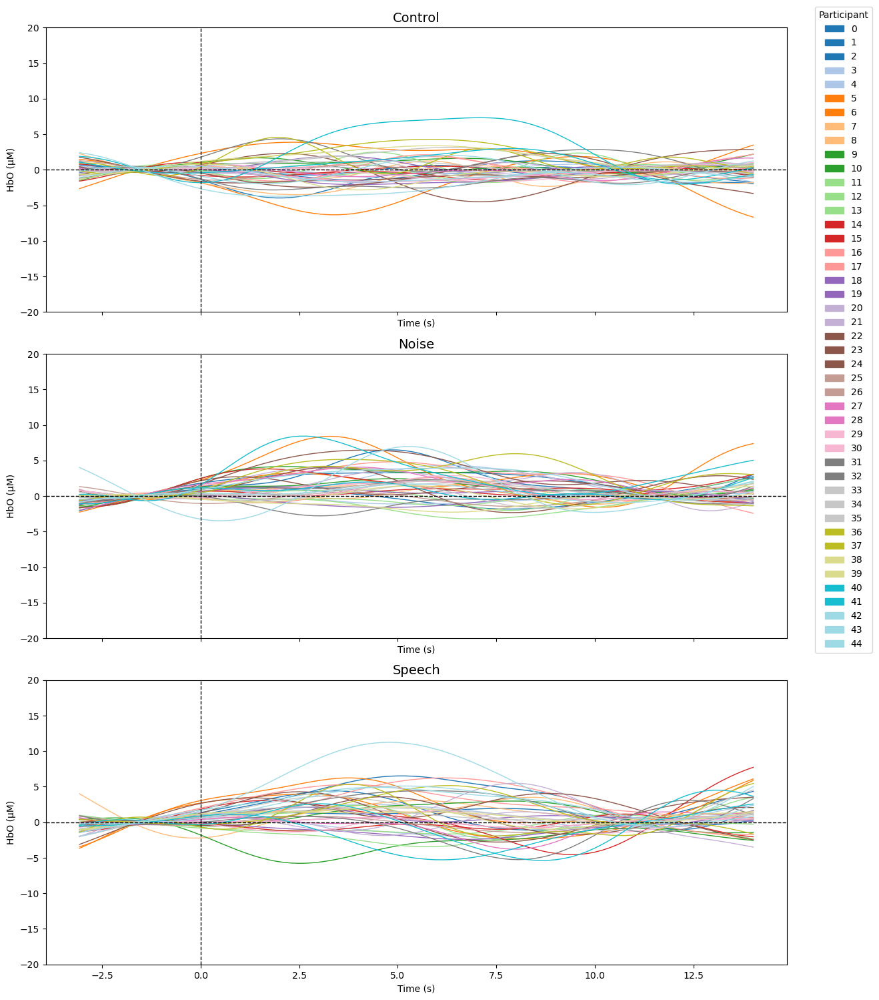

In [84]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.patches import Patch
import matplotlib.cm as cm

for optode in optodes:
    all_evokeds = all_evokeds_dict[optode]
    print(f"Optode: {optode}; Number of sessions: {len(all_evokeds['Control'])}")

    # Create subplots in 3 rows and 1 column
    fig, axes = plt.subplots(nrows=len(all_evokeds), ncols=1, figsize=(12, 15), sharey=True, sharex=True)


    y_min, y_max = -20, 20

    # Create unique colors for each participant
    num_participants = len(next(iter(all_evokeds.values())))  # assumes all conditions have same participants
    cmap = cm.get_cmap("tab20", num_participants)
    participant_colors = [cmap(i) for i in range(num_participants)]

    # Prepare legend handles
    legend_handles = [Patch(color=participant_colors[i], label=f"{i}") for i in range(num_participants)]

    # Iterate over each condition and plot
    for idx, (condition, evoked_list) in enumerate(all_evokeds.items()):
        ax = axes[idx]
        times = evoked_list[0].times

        # Extract only HbO data
        hbo_data = np.array([evoked.copy().pick("hbo").data for evoked in evoked_list])  # shape: (n_participants, n_channels, n_times)

        # Compute a dictionary of means across participants should be size n_participants x n_times
        mean_channels_all_part = np.zeros((len(hbo_data), hbo_data[0].shape[1]))  # (n_participants, n_times)
        for i in range(len(hbo_data)):
            mean_channels_all_part[i, :]= np.mean(hbo_data[i], axis=0)  # (n_channels, n_times)
        
        # Compute mean across participants
        mean_hbo = np.mean(hbo_data, axis=0)  # (n_channels, n_times)
        
        

        # Plot individual participants with unique color
        for i, participant_hbo in enumerate(hbo_data):
            ax.plot(times, mean_channels_all_part[i,:]* 1e6, color=participant_colors[i], alpha=1, linewidth=1)

        # Plot the mean in black
        #ax.plot(times, mean_hbo*1e6, color="black", linewidth=2, label="Mean HbO")

        # Axes formatting
        ax.axhline(0, color='black', linewidth=1, linestyle='--')
        ax.axvline(0, color='black', linewidth=1, linestyle='--')
        ax.set_title(condition, fontsize=14)
        ax.set_xlabel("Time (s)")
        ax.set_ylabel("HbO (μM)")

    # Add one shared legend for all participants
    fig.legend(handles=legend_handles, loc="upper right", title="Participant", bbox_to_anchor=(1.1, 1))

    plt.ylim(y_min, y_max)
    plt.tight_layout()
    plt.show()
